# 1. Bibliotecas necesarias 

In [1]:
import pandas as pd
import numpy as np
import scipy as sp
from scipy.fftpack import rfft,rfftfreq
import matplotlib.pyplot as plt
from scipy import signal
import decimal,math
import glob


import biosignalsnotebooks as bsnb


from sklearn.feature_selection import RFECV


from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import cross_validate

from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier


# 2. Caracteristicas de la Señal EMG

### Dominio del Tiempo

In [2]:
#Características de las señales EMG
##Dominio del tiempo

#Relaciona la fuerza constante y las contracciones no fatigantes
#RMS
def RMS(datos,ratio):
    
    datosDevueltos=np.array([])
   
    if (ratio==0):
        return None

    i=0
    while i < datos.size:
        
        ratioN=0
        j=i
        i=i+int(ratio)
        sumaLocal=0
        #Para cada i , recorro sus "ratio" siguientes
        while j < i and j < datos.size:
            sumaLocal=sumaLocal+(datos[j]*datos[j])
            j=j+1
            ratioN=ratioN+1
         
        
        sumaTotal=sumaLocal/ratioN
        resultado=math.sqrt(sumaTotal) 
        
        datosDevueltos=np.append(datosDevueltos,resultado)
            
    
    

    return range(datosDevueltos.size),datosDevueltos





#También llamdado MAV= 1/N * Σ|xi|
#Mean Absolute Value
# es un metodo que detecta y mide los niveles de contraccion muscular
def MAV(datos,ratio):
    
    
    datosDevueltos = np.array([])
    
    i=0
    while i < datos.size:
        
        ratioN=0
        j=i
        i=i+int(ratio)
        sumaLocal=0
        #Para cada i , recorro sus "ratio" siguientes
        while j < i and j < datos.size:
            sumaLocal=sumaLocal+abs(datos[j])
            j=j+1
            ratioN=ratioN+1
         
        
        datosDevueltos=np.append(datosDevueltos,sumaLocal/ratioN)
        
    return range(datosDevueltos.size),datosDevueltos





#X0=X1 - X0 aplicado a todo
#Mean Absolute Value Slope
# Es la estimación de la diferencia entre segmentos de valor absoluto contiguos
def MAVS(datos,ratio):
    
    valorDevuelto=np.array([])
    x,y=MAV(datos,ratio)
    
    i=0
    while i< y.size -1 :
        valorDevuelto=np.append(valorDevuelto,(y[i+1]-y[i]))
        i+=1
        
        
    return range(valorDevuelto.size),valorDevuelto




#Cruces por cero -> Vooltaje umbral por defecto de 0.01
def ZCT(datos,voltajeUmbral=0.01):
    
    i=0
    contador=0
    while i < datos.size-1:
        
        if (((datos[i] > 0 and datos[i+1]<0) or (datos[i]<0 and datos[i+1]>0)) and (abs(datos[i]-datos[i+1])>= voltajeUmbral)):
            contador+=1
        i+=1
        
    return contador
    

def ZC(datos,ratio,voltajeUmbral=0.01):
    
    
    datosDevueltos=np.array([])
    i=0
    while i < datos.size:
 
        j=i
        contadorLocal=0
        i+=int(ratio)
        
        while j < i-1 and j< datos.size-1:
        
            if (((datos[j] > 0 and datos[j+1]<0) or (datos[j]<0 and datos[j+1]>0)) and (abs(datos[j]-datos[j+1])>= voltajeUmbral)):
                contadorLocal+=1
                
            j+=1
        
        
        #if (contadorLocal != 0):
        datosDevueltos=np.append(datosDevueltos,contadorLocal)
          
        
        
    return range(datosDevueltos.size),datosDevueltos







#Nos da información sobre complejidad de la forma de onda. Es una medida
#de la amplitud,frecuencia y duración en un solo parametro 
#Indica una medida de la amplitud, frecuencia y duración de la forma de onda.
def WL(datos,ratio):
    
    datosDevueltos=np.array([])
    i=0
    
    while i < datos.size:
        
        j=i
        sumaLocal=0
        i+=int(ratio)
        
        while j < i-1 and j< datos.size-1:
            sumaLocal=sumaLocal+abs(datos[j+1]-datos[j])
            j+=1
            
            
            
        datosDevueltos=np.append(datosDevueltos,sumaLocal)
    
    return range(datosDevueltos.size),datosDevueltos






#Cambios de signo de pendiente
#Mide el contenido de la frecuencia de la señal
#contando el número de veces que la pendiente de la forma de 
#onda cambia de signo
# Slope Sign Changes
def SSC(datos,ratio,voltajeUmbral=0.01):
    
    datosDevueltos=np.array([])
    #Dado que compara x(i) con x(i-1) y x(i+1)
    i=1
    while i < datos.size:
 
        j=i
        contadorLocal=0
        i+=int(ratio)
        #-2 dado que i comienza en 1
        while j < i-2 and j< datos.size-1:
            if(((datos[j]> datos[j-1] and datos[j]>datos[j+1]) or (datos[j] < datos[j-1] and datos[j]<datos[j+1] )) and (abs(datos[j]-datos[j+1])>= voltajeUmbral or abs(datos[j]-datos[j-1])>=voltajeUmbral)):
                contadorLocal+=1
                
            j+=1
        
        
        #if (contadorLocal != 0):
        datosDevueltos=np.append(datosDevueltos,contadorLocal)
          
        
        
    return range(datosDevueltos.size),datosDevueltos



#integrated EMG (IEMG)
# Normalmente es usada como 
def IEMG(datos,ratio):
    
    datosDevueltos = np.array([])
    
    i=0
    while i < datos.size:
        
        j=i
        i=i+int(ratio)
        sumaLocal=0
        #Para cada i , recorro sus "ratio" siguientes
        while j < i and j < datos.size:
            sumaLocal=sumaLocal+abs(datos[j])
            j=j+1
         
        
        datosDevueltos=np.append(datosDevueltos,sumaLocal)
        
    return range(datosDevueltos.size),datosDevueltos






#Simple Square Integral (SSI)
def SSI(datos,ratio):
    
    datosDevueltos = np.array([])
    
    i=0
    while i < datos.size:
        
        j=i
        i=i+int(ratio)
        sumaLocal=0
        #Para cada i , recorro sus "ratio" siguientes
        while j < i and j < datos.size:
            sumaLocal=sumaLocal+(datos[j]*datos[j])
            j=j+1
         
        
        datosDevueltos=np.append(datosDevueltos,sumaLocal)
        
    return range(datosDevueltos.size),datosDevueltos





#VAR (variance of EMG)
def VAR(datos,ratio):
    
    datosDevueltos=np.array([])
   
    i=0
    while i < datos.size:
        
        ratioN=0
        j=i
        i=i+int(ratio)
        sumaLocal=0
        #Para cada i , recorro sus "ratio" siguientes
        while j < i and j < datos.size:
            sumaLocal=sumaLocal+(datos[j]*datos[j])
            j=j+1
            ratioN=ratioN+1
         
        
        if (ratioN == 1):
            ratioN=2
            
        resultado=sumaLocal/(ratioN-1)
        
        datosDevueltos=np.append(datosDevueltos,resultado)
            
    
    

    return range(datosDevueltos.size),datosDevueltos



#Valor absoluto en el tercer, cuarto y quinto momento
def TM3(datos, ratio):
    
    datosDevueltos=np.array([])
    
    
    i=0
    while i < datos.size:
        ratioN=0
        j=i
        i=i+int(ratio)
        sumaLocal=0
        while j< i and j< datos.size:
            sumaLocal=sumaLocal+pow(datos[j],3)
            j=j+1
            ratioN=ratioN+1
            
        resultado=abs(sumaLocal/ratioN)
        
        datosDevueltos=np.append(datosDevueltos,resultado)
        
    return range(datosDevueltos.size),datosDevueltos



def TM4(datos, ratio):
    
    datosDevueltos=np.array([])
    
    
    i=0
    while i < datos.size:
        ratioN=0
        j=i
        i=i+int(ratio)
        sumaLocal=0
        while j< i and j< datos.size:
            sumaLocal=sumaLocal+pow(datos[j],4)
            j=j+1
            ratioN=ratioN+1
            
        resultado=sumaLocal/ratioN
        
        datosDevueltos=np.append(datosDevueltos,resultado)
        
    return range(datosDevueltos.size),datosDevueltos


def TM5(datos, ratio):
    
    datosDevueltos=np.array([])
    
    
    i=0
    while i < datos.size:
        ratioN=0
        j=i
        i=i+int(ratio)
        sumaLocal=0
        while j< i and j< datos.size:
            sumaLocal=sumaLocal+pow(datos[j],5)
            j=j+1
            ratioN=ratioN+1
            
        resultado=abs(sumaLocal/ratioN)
        
        datosDevueltos=np.append(datosDevueltos,resultado)
        
    return range(datosDevueltos.size),datosDevueltos


#Log detector
#Da información de las contracciones musculares
def LOG(datos,ratio):
    
    datosDevueltos=np.array([])
    
    i=0
    while i < datos.size:
        ratioN=0
        j=i
        i=i+int(ratio)
        sumaLocal=0
        while j< i and j< datos.size:
            if(datos[j] != 0):
                sumaLocal=sumaLocal+math.log(abs(datos[j]))
            j=j+1
            ratioN=ratioN+1
            
        resultado=math.exp(sumaLocal/ratioN)
        
        datosDevueltos=np.append(datosDevueltos,resultado)
        
    return range(datosDevueltos.size),datosDevueltos



#Average amplitude change --> es como WL pero con la media
def ACC(datos,ratio):
    
    datosDevueltos=np.array([])
    i=0
    
    while i < datos.size:
        
        j=i
        sumaLocal=0
        ratioN=1
        i+=int(ratio)
        
        while j < i-1 and j< datos.size-1:
            sumaLocal=sumaLocal+abs(datos[j+1]-datos[j])
            j+=1
            ratioN+=1
            
            
            
        datosDevueltos=np.append(datosDevueltos,sumaLocal/ratioN)
    
    return range(datosDevueltos.size),datosDevueltos



### Dominio de la frecuencia

In [3]:
#Dominio de la frecuencia
def FFT(datos,fs):
    
    
    tam=datos.size
    T=1.0/fs
    datosY=rfft(datos)
    datosX=rfftfreq(tam,d=T)
    
    return datosX,abs(datosY)


def PSD(datos,fs=1024.0):
    x,y = signal.welch(datosFiltrados,fs,nperseg=int(fs))
    
    return x,y


# Filtro mediana(Median--> MDF)
#Devuelve una lista con los valores de la mediana
def MDF(datos,ratio,fs=1024.0):
    
    datosDevueltos=np.array([])
    lista=[]
    datosProcesados=[]
   
    if (ratio==0):
        return None

    
    i=0
    while i< len(datos):
        
        lista.append(datos[i])
        if (len(lista)==ratio or i == len(datos)-1):
            frecuencia,poder = signal.welch(lista,fs,nperseg=len(lista))
            #Lista de vectores
            datosProcesados.append(poder)
            lista.clear()
        i=i+1
        
    
    for seccion in datosProcesados:
        suma=seccion.sum()/2
        datosDevueltos=np.append(datosDevueltos,suma)
    
    return range(datosDevueltos.size),datosDevueltos


#Filtro media (MNF)
# sumatoria(fi*Pi)/sumatoria(Pi)
# (f0*P0) + (f1*P1)...N / P0+P1+P2...N

def MNF(datos,ratio,fs=1024.0):
    
    datosDevueltos=np.array([])
    lista=[]
    datosPod=[]
    datosFre=[]
    
    if (ratio==0):
        return None

    
    i=0
    while i< len(datos):
        
        lista.append(datos[i])
        if (len(lista)==ratio or i == len(datos)-1):
            frecuencia,poder = signal.welch(lista,fs,nperseg=len(lista))
            datosPod.append(poder)
            datosFre.append(frecuencia)
            lista.clear()
        i=i+1
        
    
    suma=[]
    
    for i,j in zip(datosPod, datosFre):
        sumaNumerador=0
        sumaDenominador=0
        for datosP,datosF in zip(i,j):
            sumaNumerador=sumaNumerador+(datosP*datosF)
            sumaDenominador=sumaDenominador+datosP
            

        datosDevueltos=np.append(datosDevueltos,sumaNumerador/sumaDenominador)

    
    return range(datosDevueltos.size),datosDevueltos
    

# 3. Prueba de algoritmos 

## Prueba con vector de datos

In [4]:
datosPrueba=np.array([10,0.01,-6,7,5,3,-9,4,6.89]) # Tam= 9 datosPrueba.size
ratio=3

#RMS
x,y = RMS(datosPrueba,ratio)
print("Valor RMS (N= 3)--> X = "+ str(list(x)) + " Y = "+ str(y))
x,y = RMS(datosPrueba,datosPrueba.size)
print("Valor RMS Total --> X = "+ str(list(x)) + " Y = "+ str(y) + "\n")


#MAV
x,y = MAV(datosPrueba,ratio)
print("Valor MAV (N=3) --> X =" + str(list(x)) + " Y = "+ str(y))
x,y = MAV(datosPrueba,datosPrueba.size)
print("Valor MAV Total --> X =" + str(list(x)) + " Y = "+ str(y) + "\n")


#MAVS
x,y = MAVS(datosPrueba,ratio)
print("Valor MAVS (N=3) --> X =" + str(list(x)) + " Y = "+ str(y))
x,y = MAV(datosPrueba,datosPrueba.size)
print("Valor MAVS Total --> X =" + str(list(x)) + " Y = "+ str(y) + "\n")


#ZC
x,y = ZC(datosPrueba,ratio)
print("Valor ZC (N= 3)--> X = "+ str(list(x)) + " Y = "+ str(y))
x,y = ZC(datosPrueba,datosPrueba.size)
print("Valor ZC Total --> X = "+ str(list(x)) + " Y = "+ str(y) + "\n")

#WL
x,y = WL(datosPrueba,ratio)
print("Valor WL (N= 3)--> X = "+ str(list(x)) + " Y = "+ str(y))
x,y = WL(datosPrueba,datosPrueba.size)
print("Valor WL Total --> X = "+ str(list(x)) + " Y = "+ str(y) + "\n")

#SSC
x,y = SSC(datosPrueba,ratio)
print("Valor SSC (N= 3)--> X = "+ str(list(x)) + " Y = "+ str(y))
x,y = SSC(datosPrueba,datosPrueba.size)
print("Valor SSC Total --> X = "+ str(list(x)) + " Y = "+ str(y) + "\n")

#IEMG
x,y = IEMG(datosPrueba,ratio)
print("Valor IEMG (N= 3)--> X = "+ str(list(x)) + " Y = "+ str(y))
x,y = IEMG(datosPrueba,datosPrueba.size)
print("Valor IEMG Total --> X = "+ str(list(x)) + " Y = "+ str(y) + "\n")

#SSI
x,y = SSI(datosPrueba,ratio)
print("Valor SSI (N= 3)--> X = "+ str(list(x)) + " Y = "+ str(y))
x,y = SSI(datosPrueba,datosPrueba.size)
print("Valor SSI Total --> X = "+ str(list(x)) + " Y = "+ str(y) + "\n")

#VAR
x,y = VAR(datosPrueba,ratio)
print("Valor VAR (N= 3)--> X = "+ str(list(x)) + " Y = "+ str(y))
x,y = VAR(datosPrueba,datosPrueba.size)
print("Valor VAR Total --> X = "+ str(list(x)) + " Y = "+ str(y) + "\n")


#TM5
x,y = TM5(datosPrueba,ratio)
print("Valor TM5 (N= 3)--> X = "+ str(list(x)) + " Y = "+ str(y))
x,y = TM5(datosPrueba,datosPrueba.size)
print("Valor TM5 Total --> X = "+ str(list(x)) + " Y = "+ str(y) + "\n")


#LOG
x,y = LOG(datosPrueba,ratio)
print("Valor LOG (N= 3)--> X = "+ str(list(x)) + " Y = "+ str(y))
x,y = LOG(datosPrueba,datosPrueba.size)
print("Valor LOG Total --> X = "+ str(list(x)) + " Y = "+ str(y) + "\n")

#ACC
x,y = ACC(datosPrueba,ratio)
print("Valor ACC (N= 3)--> X = "+ str(list(x)) + " Y = "+ str(y))
x,y = ACC(datosPrueba,datosPrueba.size)
print("Valor ACC Total --> X = "+ str(list(x)) + " Y = "+ str(y) + "\n")


Valor RMS (N= 3)--> X = [0, 1, 2] Y = [6.73300577 5.25991128 6.9395509 ]
Valor RMS Total --> X = [0] Y = [6.3549823]

Valor MAV (N=3) --> X =[0, 1, 2] Y = [5.33666667 5.         6.63      ]
Valor MAV Total --> X =[0] Y = [5.65555556]

Valor MAVS (N=3) --> X =[0, 1] Y = [-0.33666667  1.63      ]
Valor MAVS Total --> X =[0] Y = [5.65555556]

Valor ZC (N= 3)--> X = [0, 1, 2] Y = [1. 0. 1.]
Valor ZC Total --> X = [0] Y = [4.]

Valor WL (N= 3)--> X = [0, 1, 2] Y = [16.    4.   15.89]
Valor WL Total --> X = [0] Y = [60.89]

Valor SSC (N= 3)--> X = [0, 1, 2] Y = [0. 0. 0.]
Valor SSC Total --> X = [0] Y = [3.]

Valor IEMG (N= 3)--> X = [0, 1, 2] Y = [16.01 15.   19.89]
Valor IEMG Total --> X = [0] Y = [50.9]

Valor SSI (N= 3)--> X = [0, 1, 2] Y = [136.0001  83.     144.4721]
Valor SSI Total --> X = [0] Y = [363.4722]

Valor VAR (N= 3)--> X = [0, 1, 2] Y = [68.00005 41.5     72.23605]
Valor VAR Total --> X = [0] Y = [45.434025]

Valor TM5 (N= 3)--> X = [0, 1, 2] Y = [30741.33333333  6725.      

# 4. Prueba con datos EMG 

### A) Calculo de archivos EMG más definidos (con las 12 repeticiones más claras)

In [27]:
def hallarArchivosEMG():
    
    fs=1024
    dataset=glob.glob("../Estudio tDCS/*.csv")
    dataset.sort()

    archivosFinales=[]
    archivos=[]
    
    
    #valoresSM=[14,15,16,17,18,19,20,21,22]
    valoresSM=[22,21,20,19,18,17,16,15,14]
    #valoresTH=[15,16,17,18,19,20,22,25,27,30,32,35,37,40,42,45,47,50,52,55,57,60]
    valoresTH=[60,57,55,52,50,47,45,42,40,37,35,32,30,27,25,22,20,19,18,17,16,15,14,13,12,11,10]

    
    for sm in valoresSM:
        
        for th in valoresTH:

            for archivo in dataset:

                if archivo not in archivos:

                    df = pd.read_csv(archivo,delimiter=";",decimal=",")
                    df=df.fillna(0)

                    #Pierna izquieda
                    vastoMedialIzquierdo= df['emg_muscle_1_(µV)'].to_numpy()
                    rectoFemoralIzquierdo=df['emg_muscle_2_(µV)'].to_numpy()

                    #Pierna derecha
                    vastoMedialDerecho=df['emg_muscle_3_(µV)'].to_numpy()
                    rectoFemoralDerecho=df['emg_muscle_4_(µV)'].to_numpy()


                    #Atributos para detectar EMG
                    plot=False
                    smooth=sm
                    threshold=th

                    activacion1=bsnb.detect_emg_activations(vastoMedialIzquierdo,fs,smooth_level=smooth, threshold_level=threshold,
                                                                time_units=False,volts=False, resolution=None,plot_result=plot)
                    
                    if (len(activacion1[0]) != 12):
                        continue
                    
                    activacion2=bsnb.detect_emg_activations(rectoFemoralIzquierdo,fs,smooth_level=smooth, threshold_level=threshold,
                                                                time_units=False,volts=False, resolution=None,plot_result=plot)

                    if (len(activacion2[0]) != 12):
                        continue
                    
                    activacion3=bsnb.detect_emg_activations(vastoMedialDerecho,fs,smooth_level=smooth, threshold_level=threshold,
                                                                time_units=False,volts=False, resolution=None,plot_result=plot)
                    
                    if (len(activacion3[0]) != 12):
                        continue
                    activacion4=bsnb.detect_emg_activations(rectoFemoralDerecho,fs,smooth_level=smooth, threshold_level=threshold,
                                                                time_units=False,volts=False, resolution=None,plot_result=plot)
                    if (len(activacion4[0]) != 12):
                        continue

                    datosImportantes=[]
                    datosImportantes.append(archivo)
                    datosImportantes.append(threshold)
                    datosImportantes.append(smooth)
                    archivos.append(archivo)

                    archivosFinales.append(datosImportantes)
    
    return archivosFinales
    
    

In [28]:

archivosFinales=hallarArchivosEMG()



In [29]:
archivosFinales

[['../Estudio tDCS/s16 serie 3 dia 1.csv', 50, 22],
 ['../Estudio tDCS/s14 serie 1 dia 1.csv', 47, 22],
 ['../Estudio tDCS/s14 serie 3 dia 1.csv', 47, 22],
 ['../Estudio tDCS/s15 serie 1 dia 1.csv', 47, 22],
 ['../Estudio tDCS/s1 serie 3 dia 1.csv', 45, 22],
 ['../Estudio tDCS/s1 serie 1 dia 1.csv', 42, 22],
 ['../Estudio tDCS/s10 serie 1 dia 1.csv', 40, 22],
 ['../Estudio tDCS/s3 serie 2 dia 1.csv', 40, 22],
 ['../Estudio tDCS/s1 serie 2 dia 1.csv', 37, 22],
 ['../Estudio tDCS/s14 serie 2 dia 1.csv', 37, 22],
 ['../Estudio tDCS/s10 serie 3 dia 1.csv', 30, 22],
 ['../Estudio tDCS/s10 serie 2 dia 1.csv', 27, 22],
 ['../Estudio tDCS/s3 serie 1 dia 1.csv', 27, 22],
 ['../Estudio tDCS/s3 serie 1 dia 2.csv', 25, 22],
 ['../Estudio tDCS/s3 serie 3 dia 1.csv', 17, 22],
 ['../Estudio tDCS/s16 serie 1 dia 1.csv', 14, 22],
 ['../Estudio tDCS/s12 serie 3 dia 1.csv', 42, 21],
 ['../Estudio tDCS/s15 serie 2 dia 2.csv', 50, 20],
 ['../Estudio tDCS/s16 serie 2 dia 2.csv', 20, 20],
 ['../Estudio tDCS/

In [19]:
archivosFinales

[['../Estudio tDCS/s1 serie 1 dia 1.csv', 15, 14],
 ['../Estudio tDCS/s16 serie 3 dia 1.csv', 15, 14],
 ['../Estudio tDCS/s3 serie 1 dia 2.csv', 16, 14],
 ['../Estudio tDCS/s10 serie 2 dia 1.csv', 18, 14],
 ['../Estudio tDCS/s15 serie 1 dia 1.csv', 22, 14],
 ['../Estudio tDCS/s3 serie 2 dia 2.csv', 22, 14],
 ['../Estudio tDCS/s1 serie 2 dia 1.csv', 25, 14],
 ['../Estudio tDCS/s1 serie 3 dia 1.csv', 25, 14],
 ['../Estudio tDCS/s3 serie 3 dia 1.csv', 25, 14],
 ['../Estudio tDCS/s14 serie 1 dia 1.csv', 30, 14],
 ['../Estudio tDCS/s15 serie 2 dia 2.csv', 30, 14],
 ['../Estudio tDCS/s4 serie 3 dia 2.csv', 30, 15],
 ['../Estudio tDCS/s12 serie 2 dia 1.csv', 40, 15],
 ['../Estudio tDCS/s14 serie 3 dia 1.csv', 42, 15],
 ['../Estudio tDCS/s16 serie 2 dia 2.csv', 15, 16],
 ['../Estudio tDCS/s10 serie 1 dia 1.csv', 17, 16],
 ['../Estudio tDCS/s3 serie 1 dia 1.csv', 20, 17],
 ['../Estudio tDCS/s3 serie 2 dia 1.csv', 27, 17],
 ['../Estudio tDCS/s5 serie 1 dia 1.csv', 52, 17],
 ['../Estudio tDCS/s14

In [ ]:
guardarArchivos=pd.DataFrame(archivosFinales,columns=['archivo','th','sm'])  

guardarArchivos.to_csv('archivosElegidos.csv',index= False)

In [4]:

dfArchivos=pd.read_csv('archivosElegidos.csv',delimiter=",")

dfArchivos= dfArchivos.drop(dfArchivos[dfArchivos['archivo']=='../Estudio tDCS/s15 serie 1 dia 1.csv'].index)
dfArchivos= dfArchivos.drop(dfArchivos[dfArchivos['archivo']=='../Estudio tDCS/s5 serie 1 dia 1.csv'].index)
dfArchivos= dfArchivos.drop(dfArchivos[dfArchivos['archivo']=='../Estudio tDCS/s3 serie 2 dia 2.csv'].index)
dfArchivos = dfArchivos.reset_index(drop=True)

archivosElegidos=dfArchivos.values.tolist()


### B) EMG y activación

In [6]:

dfArchivos

,archivo,th,sm
0,../Estudio tDCS/s16 serie 3 dia 1.csv,50,22
1,../Estudio tDCS/s14 serie 1 dia 1.csv,47,22
2,../Estudio tDCS/s14 serie 3 dia 1.csv,47,22
3,../Estudio tDCS/s1 serie 3 dia 1.csv,45,22
4,../Estudio tDCS/s1 serie 1 dia 1.csv,42,22
5,../Estudio tDCS/s10 serie 1 dia 1.csv,40,22
6,../Estudio tDCS/s3 serie 2 dia 1.csv,40,22
7,../Estudio tDCS/s1 serie 2 dia 1.csv,37,22
8,../Estudio tDCS/s14 serie 2 dia 1.csv,37,22
9,../Estudio tDCS/s10 serie 3 dia 1.csv,30,22


In [17]:
#Elegir el primer y ultimo archivo que quiere ser mostrado
inicio=2
fin=5
for archivo in archivosElegidos[inicio:fin]:
    
    df = pd.read_csv(archivo[0],delimiter=";",decimal=",")
    df=df.fillna(0)
    
    fs=1024
    
    #Pierna izquieda
    vastoMedialIzquierdo= df['emg_muscle_1_(µV)'].to_numpy()
    rectoFemoralIzquierdo=df['emg_muscle_2_(µV)'].to_numpy()
    
    #Pierna derecha
    vastoMedialDerecho=df['emg_muscle_3_(µV)'].to_numpy()
    rectoFemoralDerecho=df['emg_muscle_4_(µV)'].to_numpy()
    
    plot=True

    print(archivo[0]+ "\n")
        
    smooth=archivo[2]
    threshold= archivo[1]
    
    
    print("vastoMedialIzquierdo")
    activacion1=bsnb.detect_emg_activations(vastoMedialIzquierdo,fs,smooth_level=smooth, threshold_level=threshold,
                                                time_units=False,volts=False, resolution=None,plot_result=plot)
    
    print("rectoFemoralIzquierdo")
    activacion2=bsnb.detect_emg_activations(rectoFemoralIzquierdo,fs,smooth_level=smooth, threshold_level=threshold,
                                                time_units=False,volts=False, resolution=None,plot_result=plot)
    
    print("vastoMedialDerecho")
    activacion3=bsnb.detect_emg_activations(vastoMedialDerecho,fs,smooth_level=smooth, threshold_level=threshold,
                                                time_units=False,volts=False, resolution=None,plot_result=plot)
    
    print("rectoFemoralDerecho")
    activacion4=bsnb.detect_emg_activations(rectoFemoralDerecho,fs,smooth_level=smooth, threshold_level=threshold,
                                                time_units=False,volts=False, resolution=None,plot_result=plot)
    

../Estudio tDCS/s14 serie 3 dia 1.csv

vastoMedialIzquierdo


rectoFemoralIzquierdo


vastoMedialDerecho


rectoFemoralDerecho


../Estudio tDCS/s1 serie 3 dia 1.csv

vastoMedialIzquierdo


rectoFemoralIzquierdo


vastoMedialDerecho


rectoFemoralDerecho


../Estudio tDCS/s1 serie 1 dia 1.csv

vastoMedialIzquierdo


rectoFemoralIzquierdo


vastoMedialDerecho


rectoFemoralDerecho


### C) Caracteristicas + Velocidad 

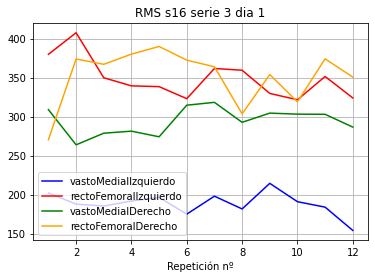

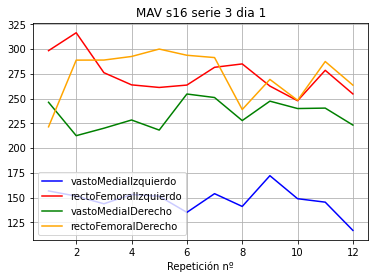

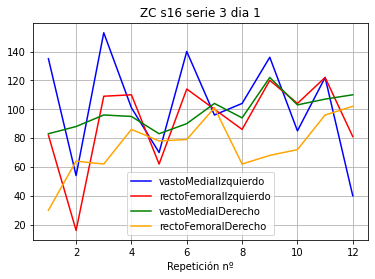

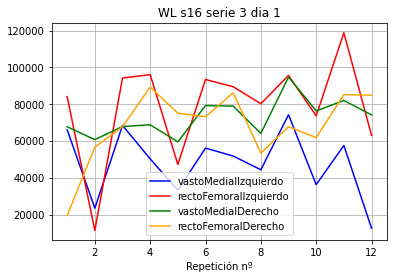

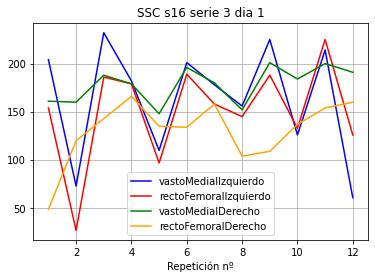

...

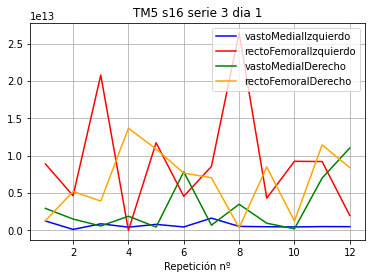

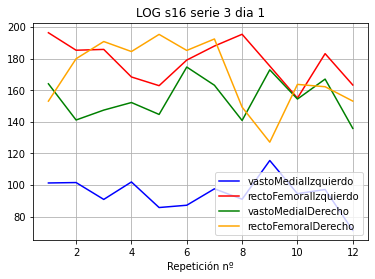

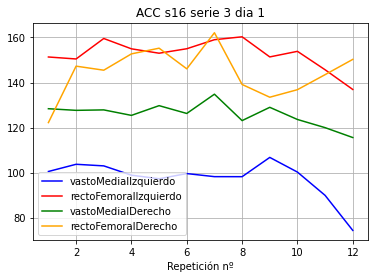

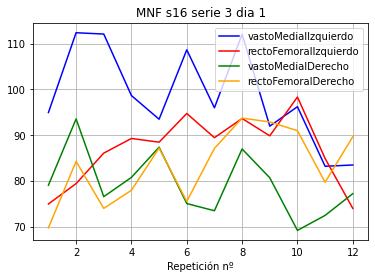

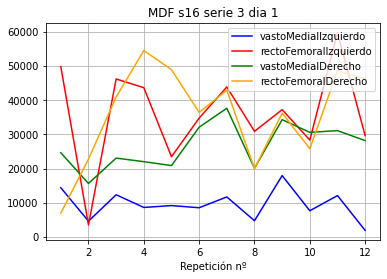

[0 0 0 0 0 0 0 0 0 0 1 1]


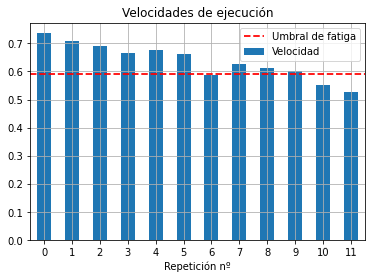

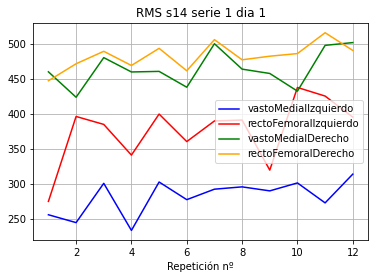

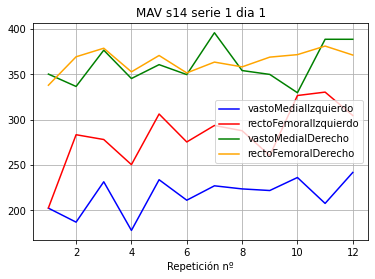

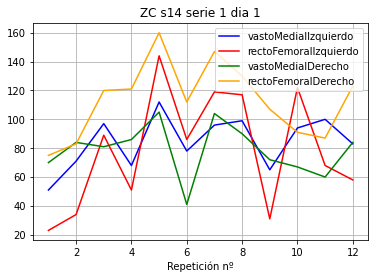

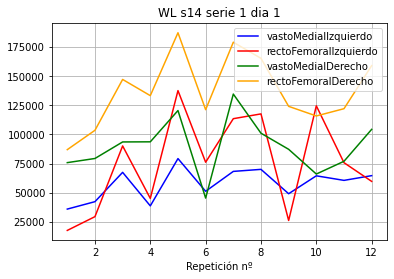

...

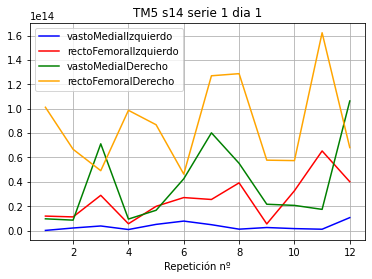

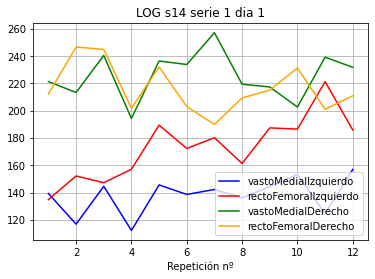

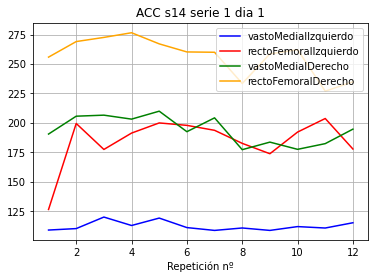

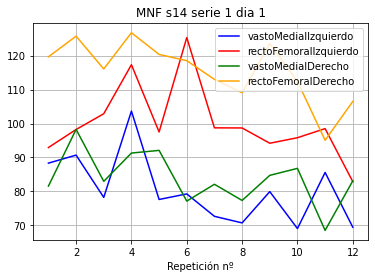

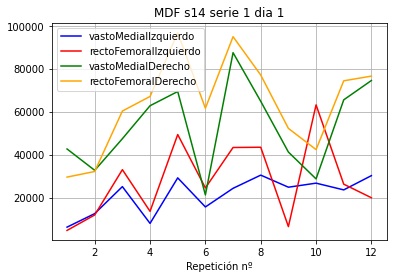

[0 0 0 0 0 0 0 0 0 0 0 0]


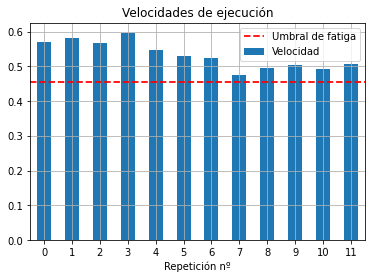

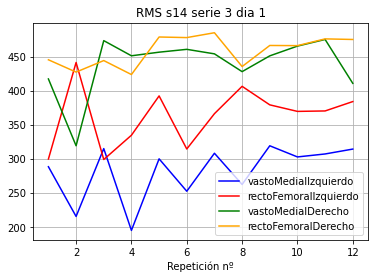

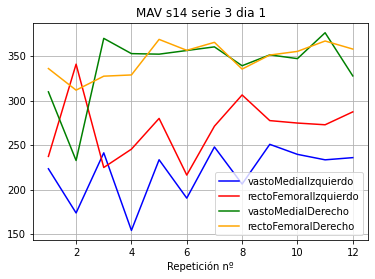

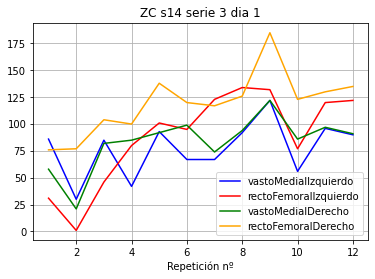

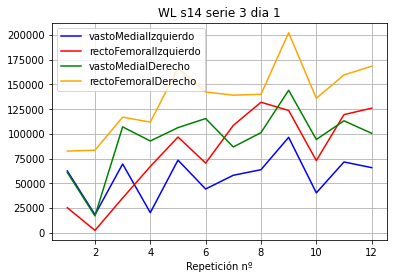

...

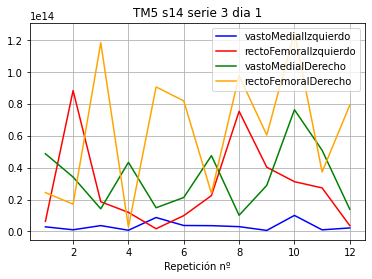

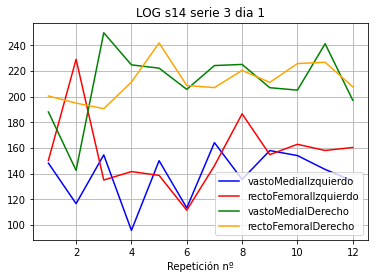

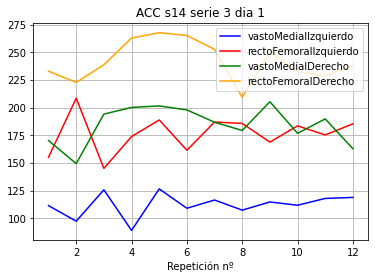

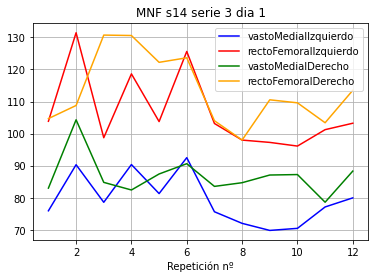

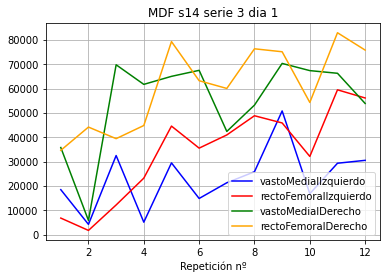

[0 0 0 0 0 0 0 0 0 0 0 0]


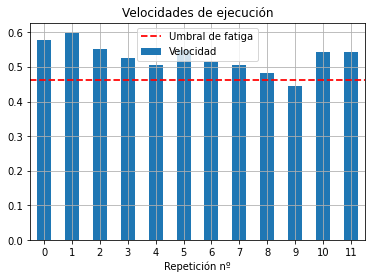

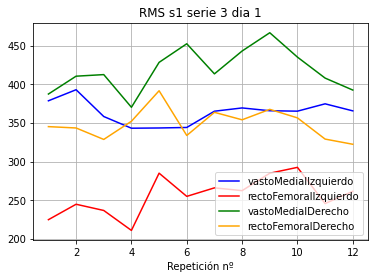

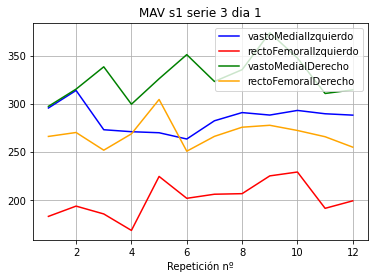

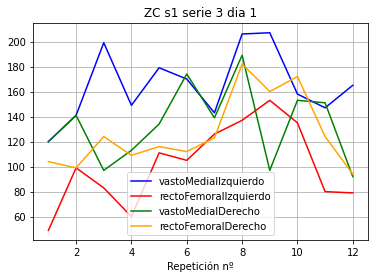

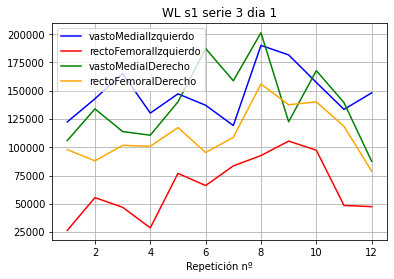

...

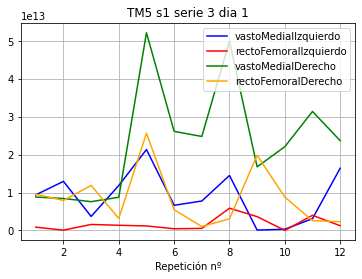

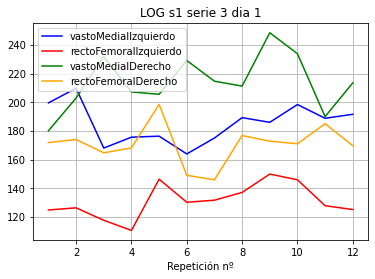

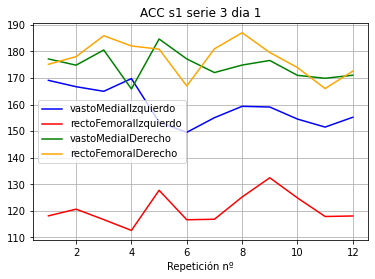

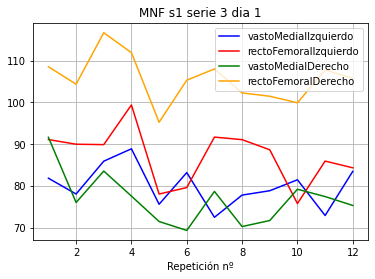

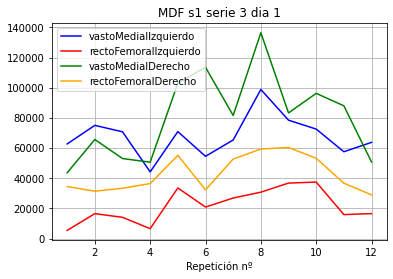

[0 0 0 0 0 0 1 1 1 1 1 1]


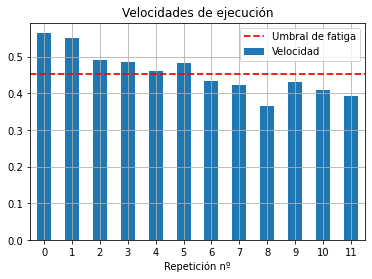

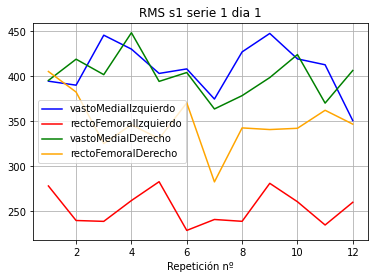

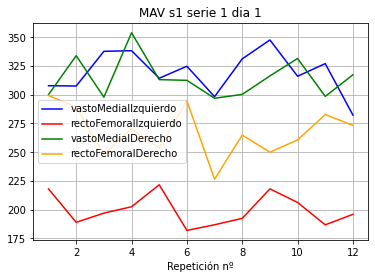

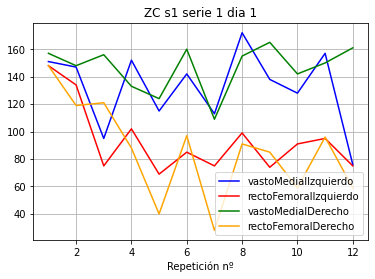

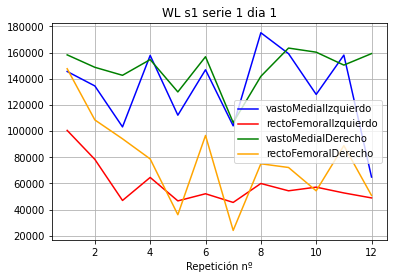

...

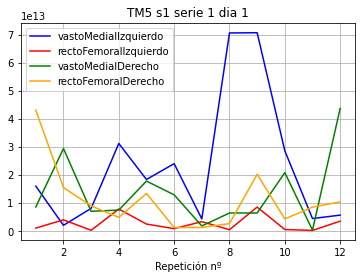

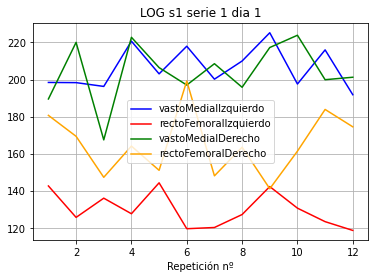

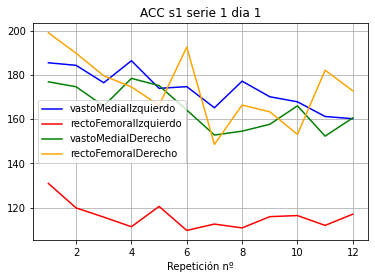

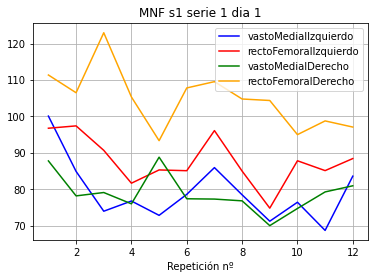

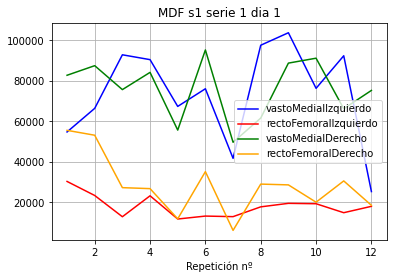

[0 0 0 0 0 0 0 0 0 0 0 0]


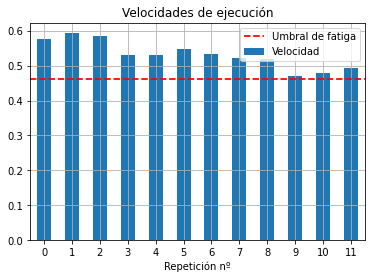

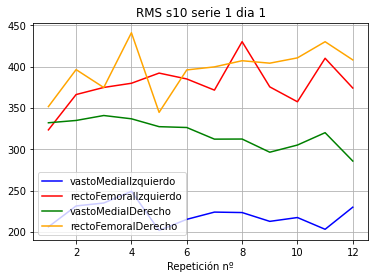

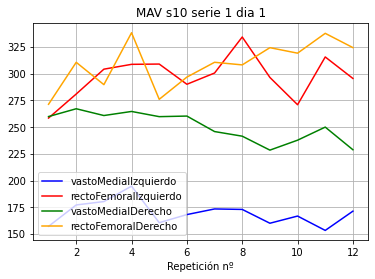

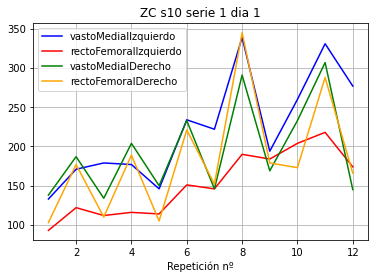

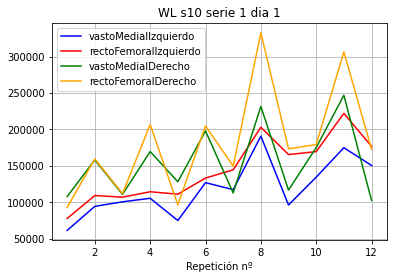

...

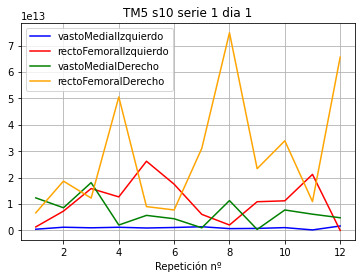

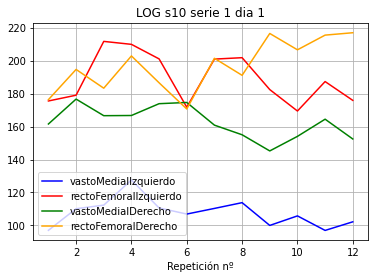

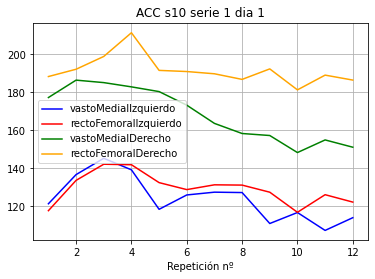

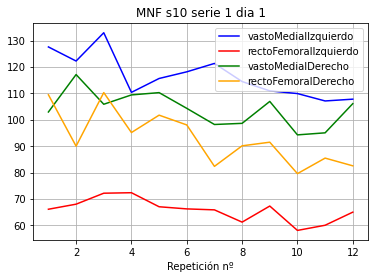

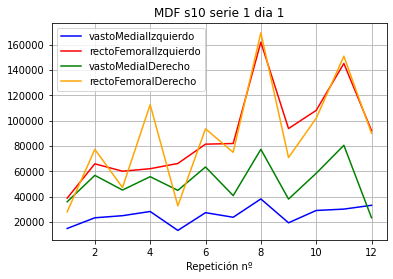

[0 0 0 0 0 0 0 0 0 0 1 1]


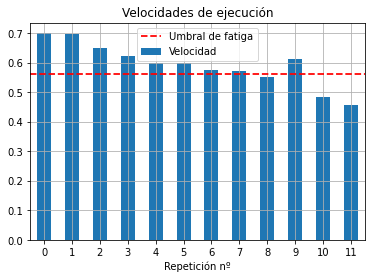

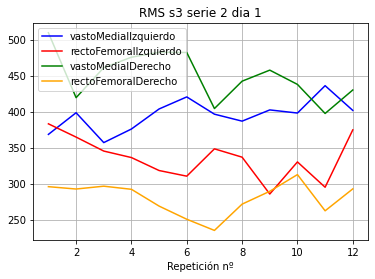

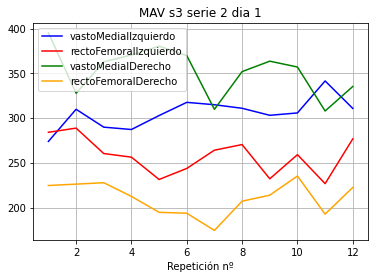

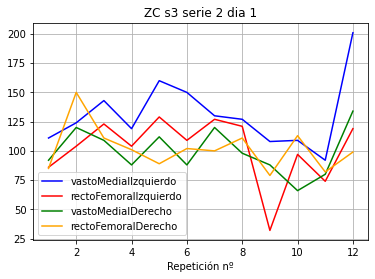

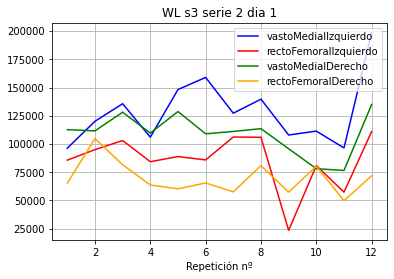

...

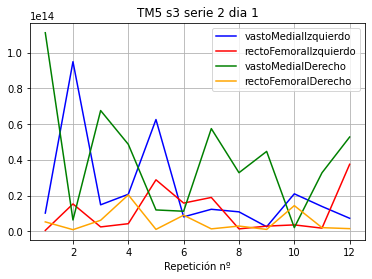

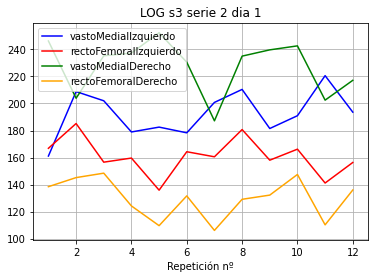

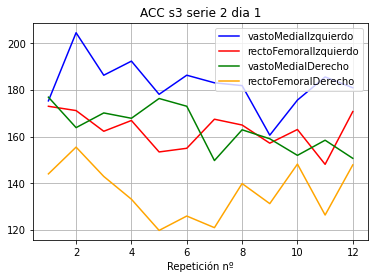

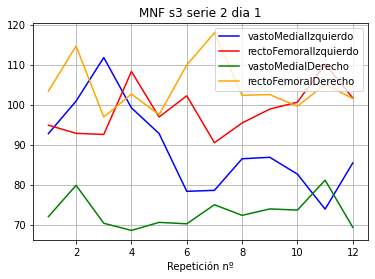

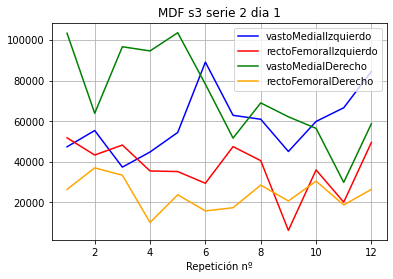

[0 1 1 1 1 1 1 1 1 1 1 1]


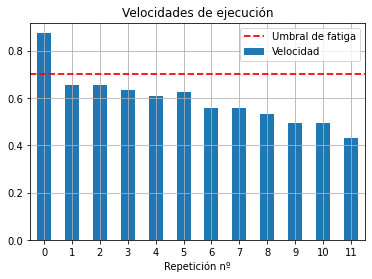

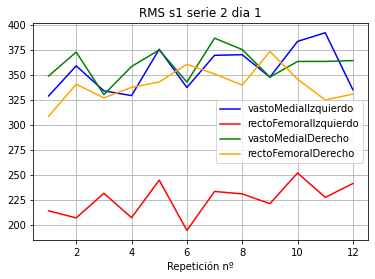

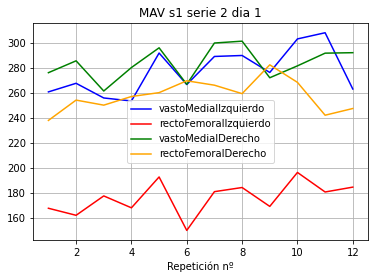

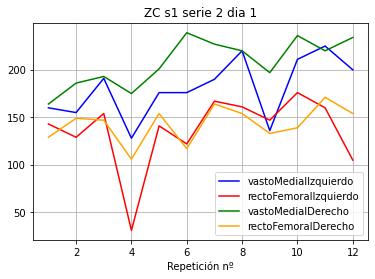

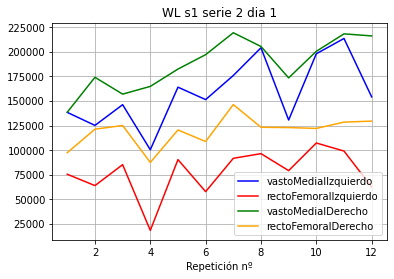

...

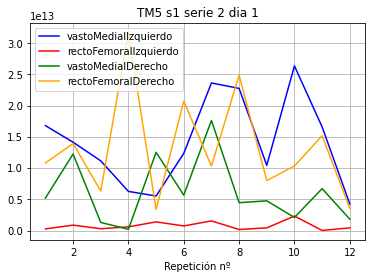

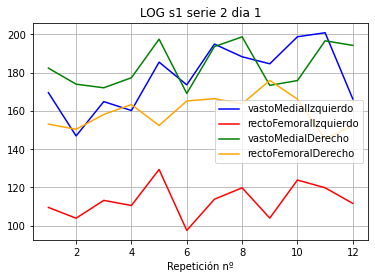

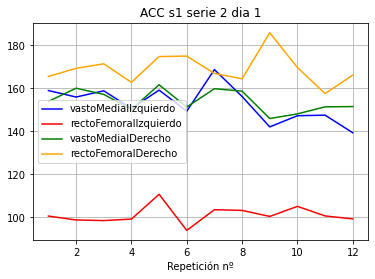

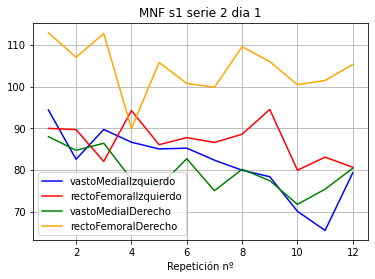

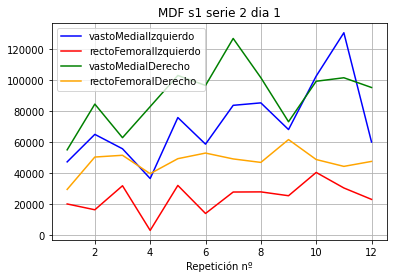

[0 0 0 0 0 0 0 0 0 1 1 1]


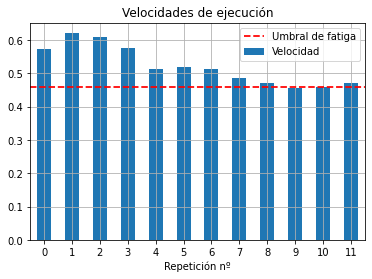

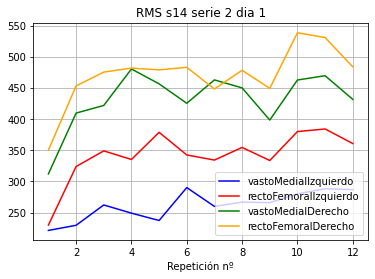

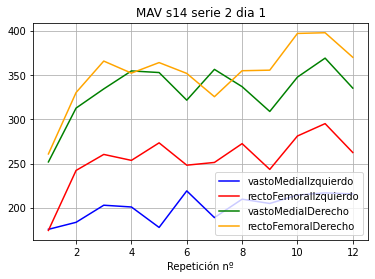

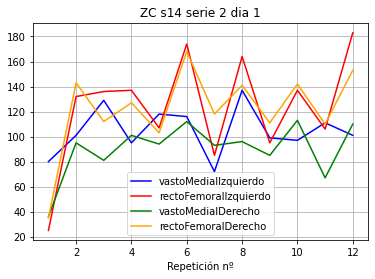

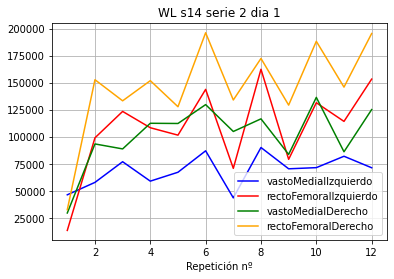

...

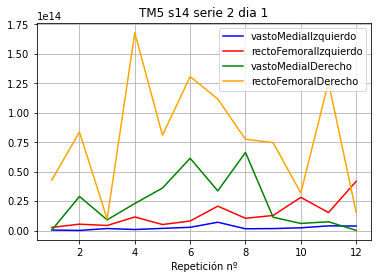

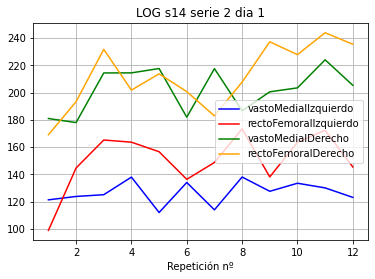

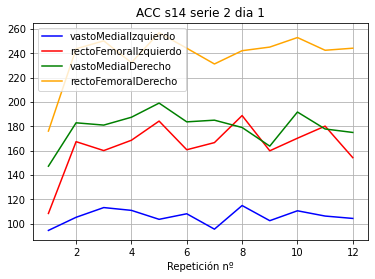

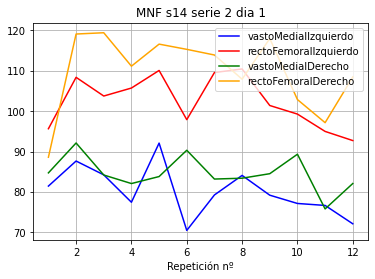

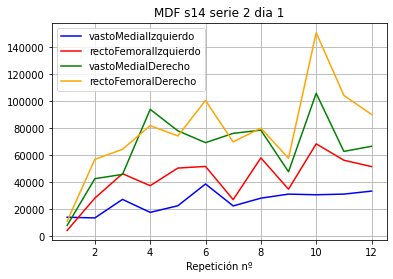

[0 0 0 0 0 0 0 0 0 0 0 0]


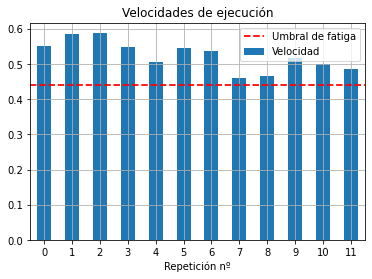

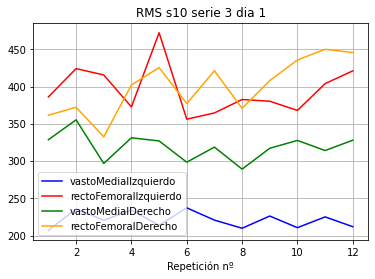

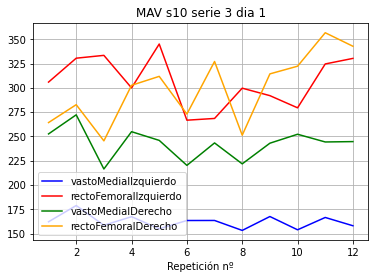

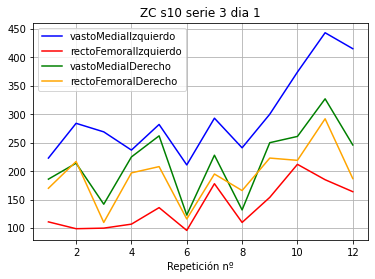

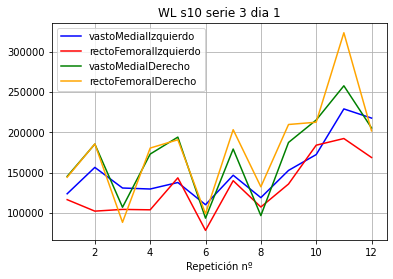

...

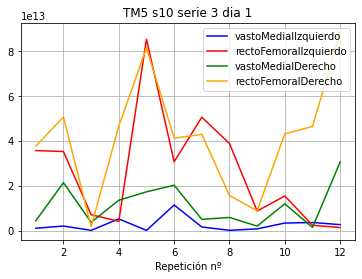

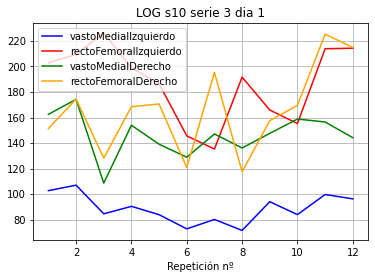

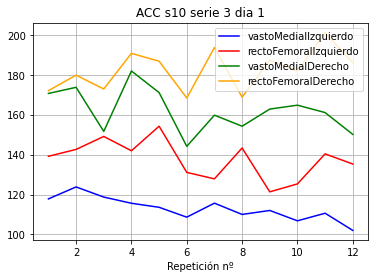

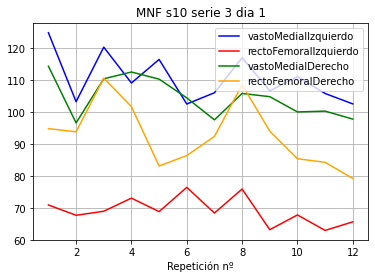

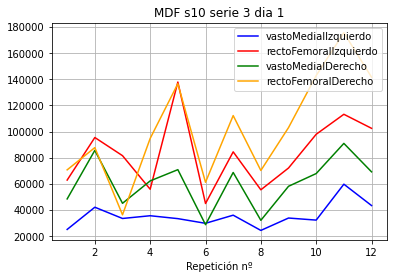

[0 0 0 0 0 0 0 0 1 1 1 1]


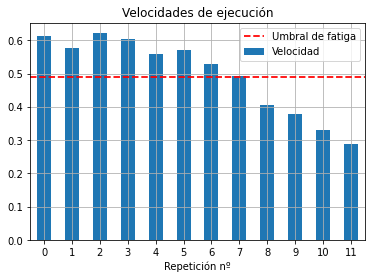

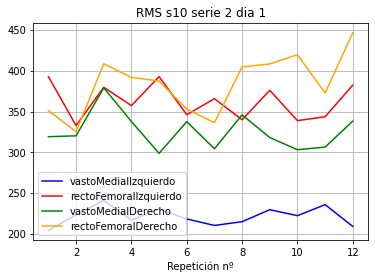

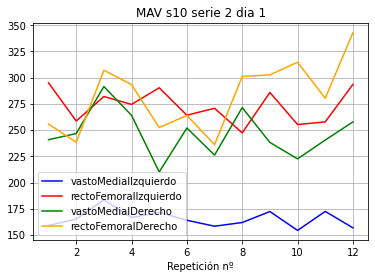

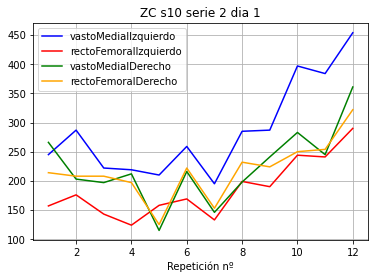

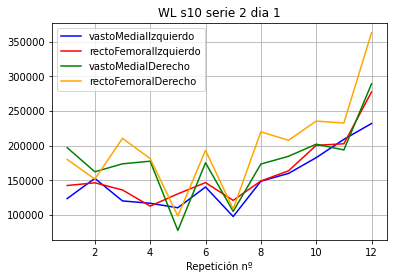

...

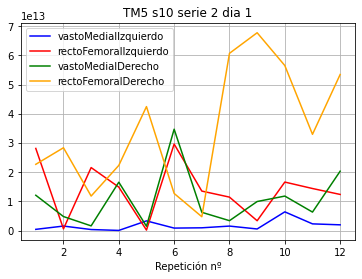

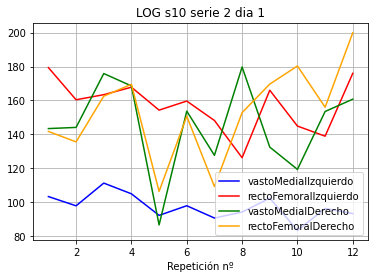

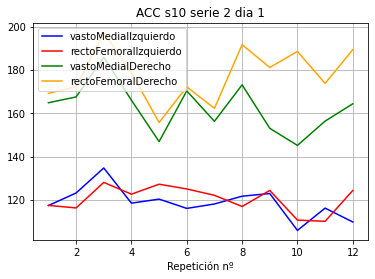

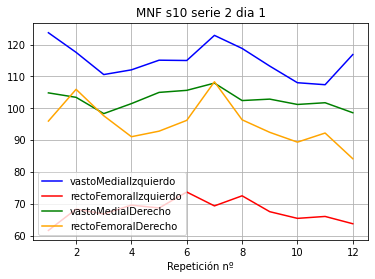

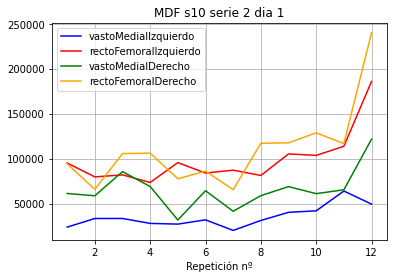

[0 0 0 0 0 0 0 0 0 1 1 1]


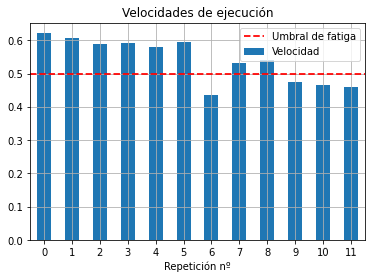

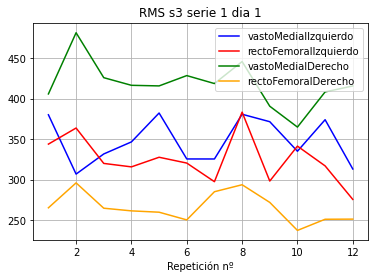

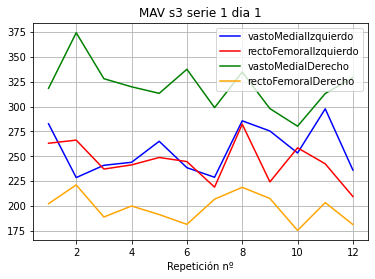

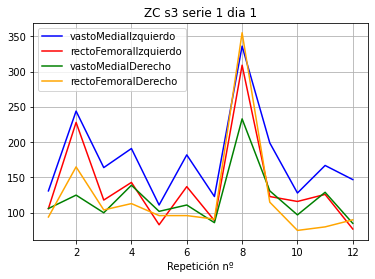

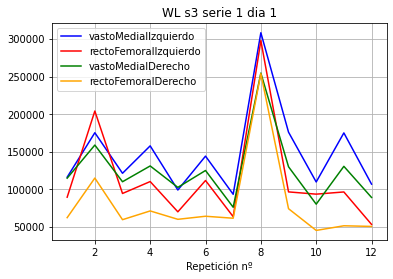

...

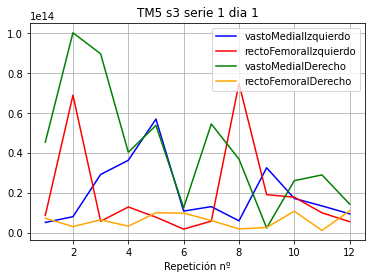

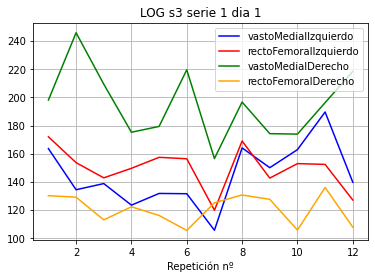

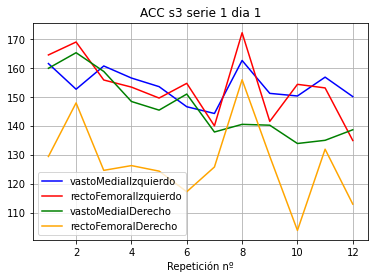

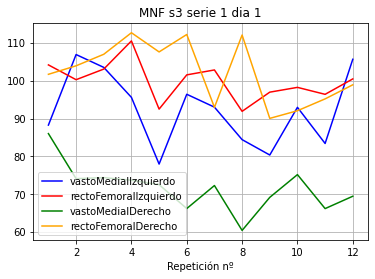

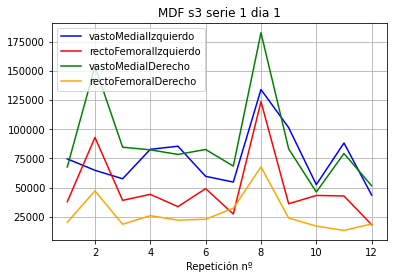

[0 0 0 0 0 0 0 0 0 0 0 0]


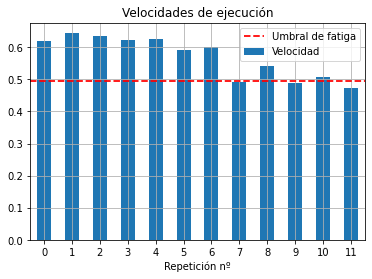

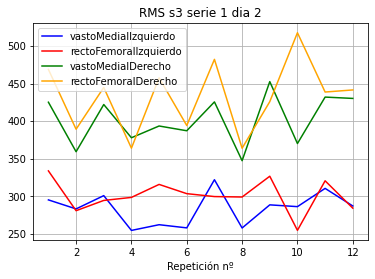

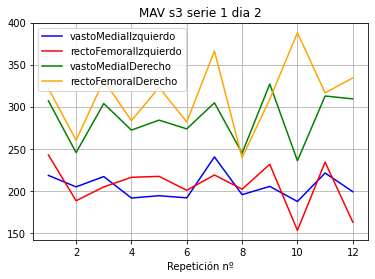

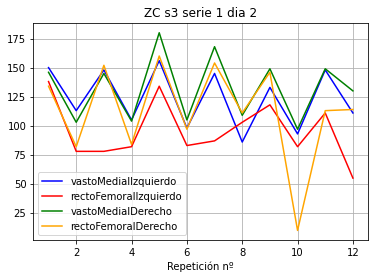

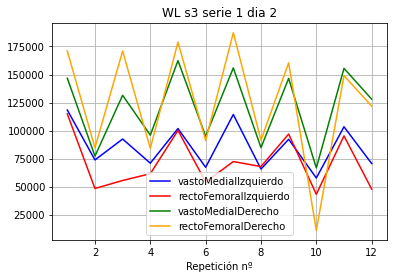

...

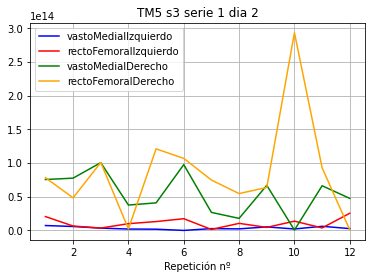

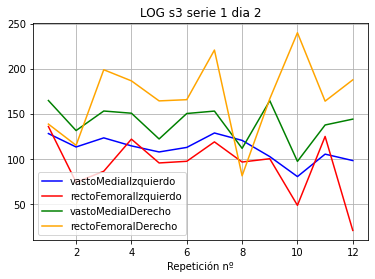

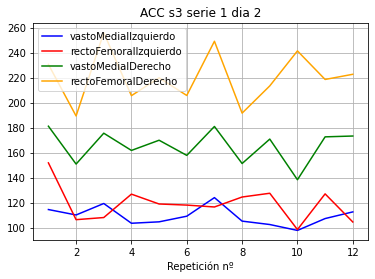

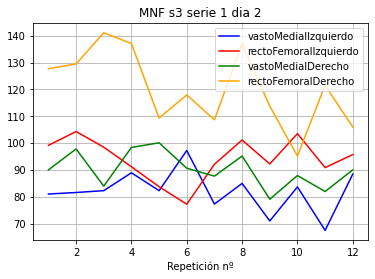

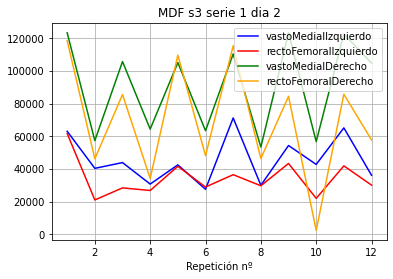

[0 0 0 0 0 0 0 0 0 0 0 0]


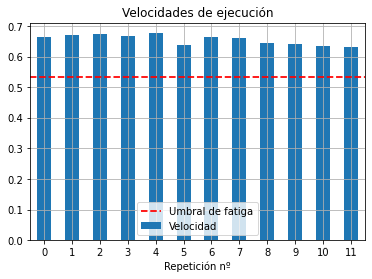

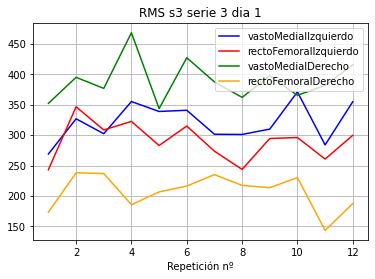

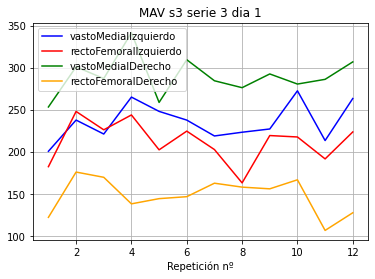

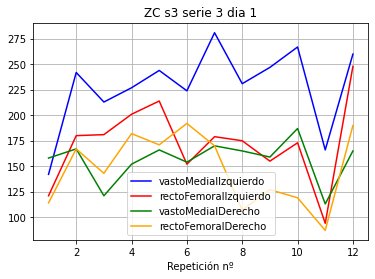

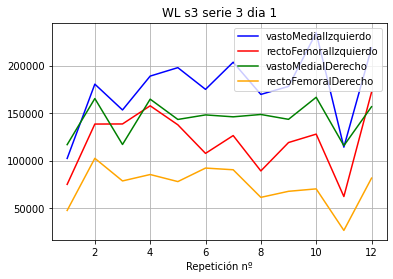

...

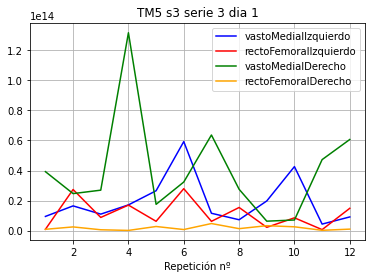

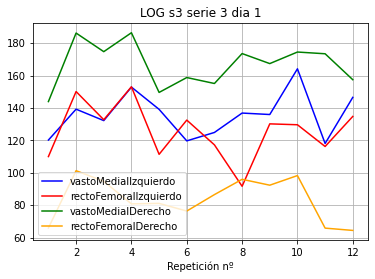

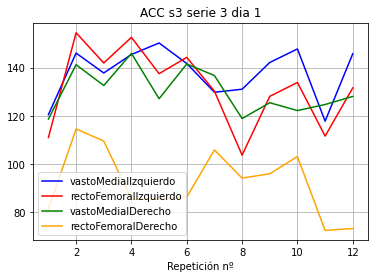

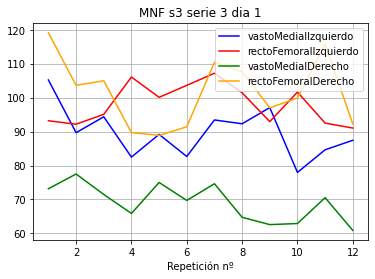

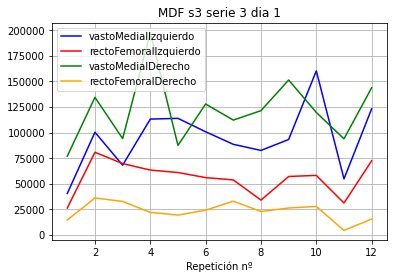

[0 0 0 0 0 0 0 0 0 1 1 1]


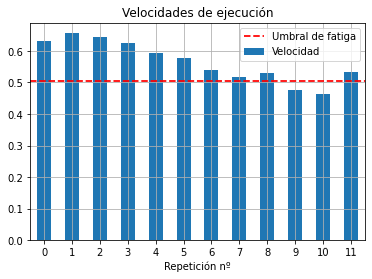

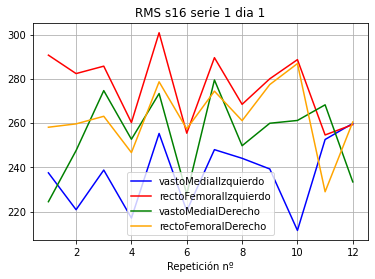

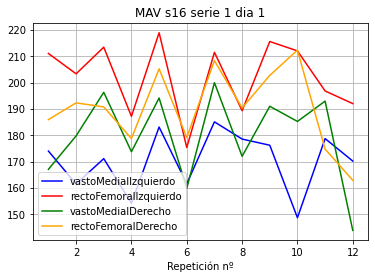

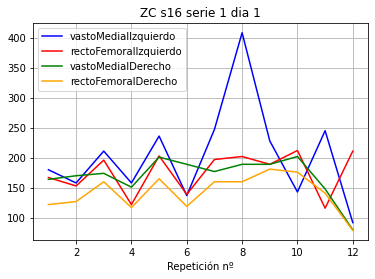

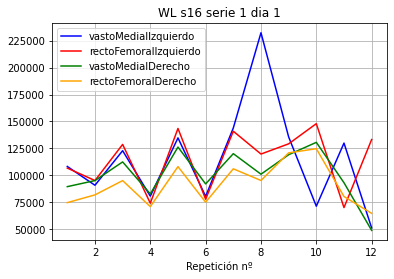

...

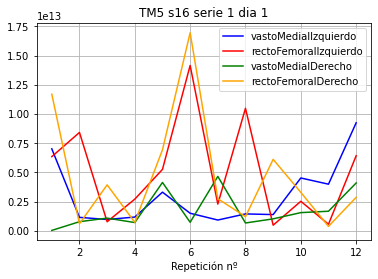

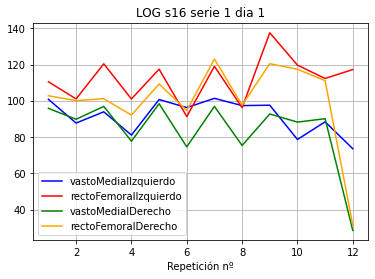

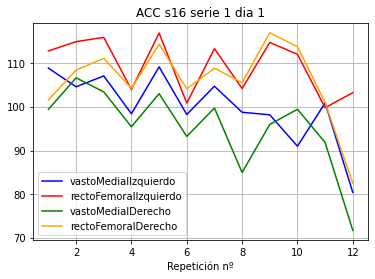

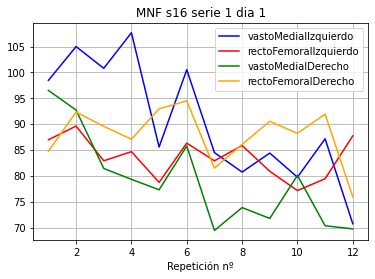

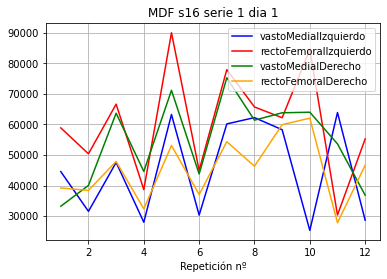

[0 0 0 0 0 0 0 0 0 0 0 0]


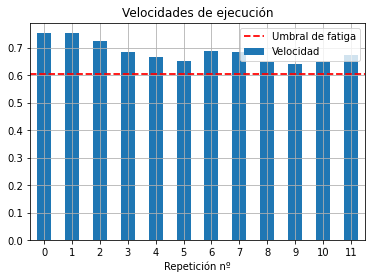

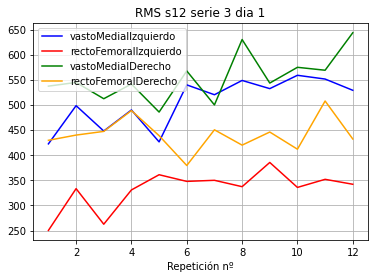

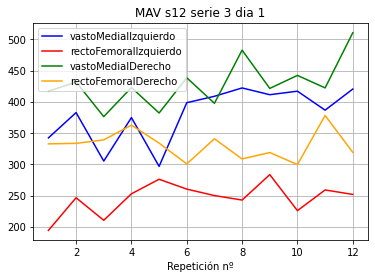

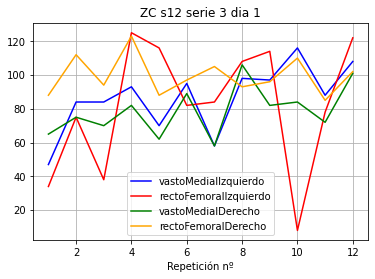

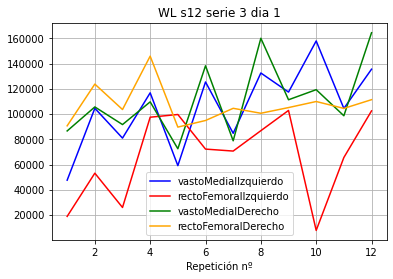

...

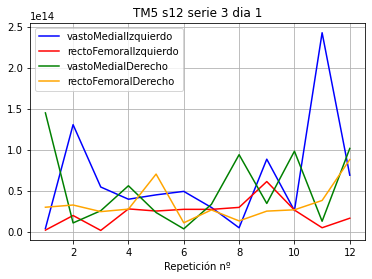

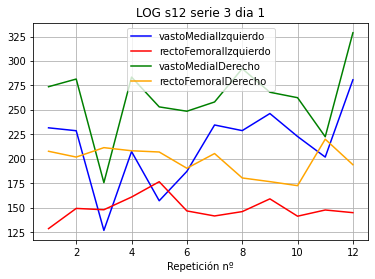

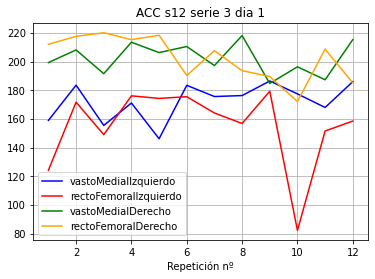

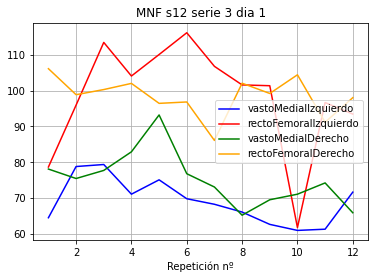

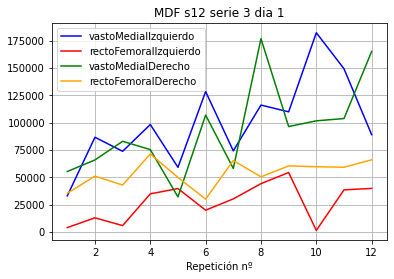

[0 0 0 0 0 0 0 0 0 0 0 0]


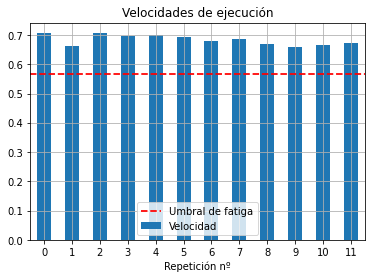

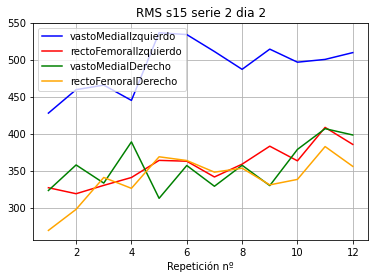

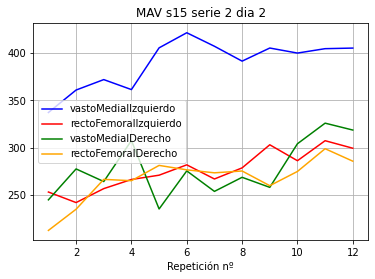

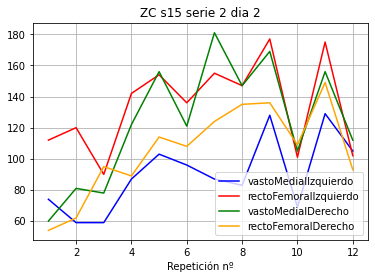

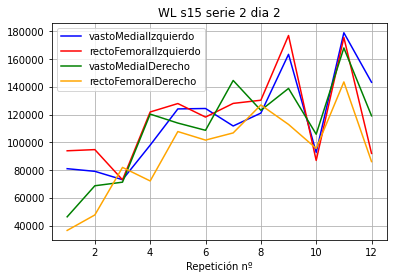

...

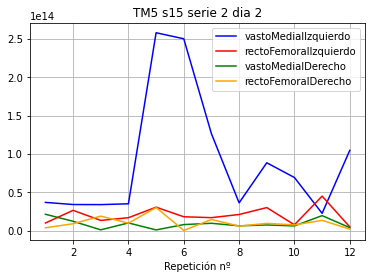

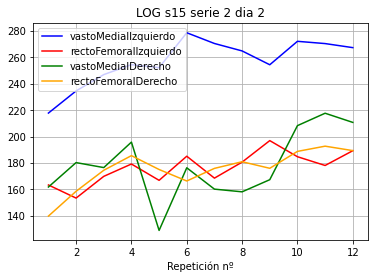

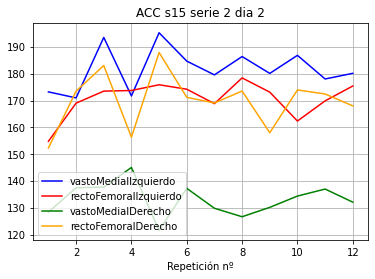

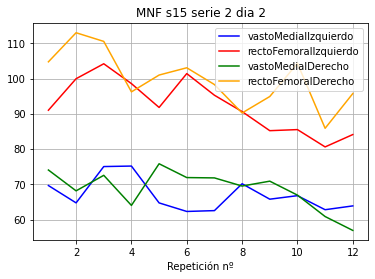

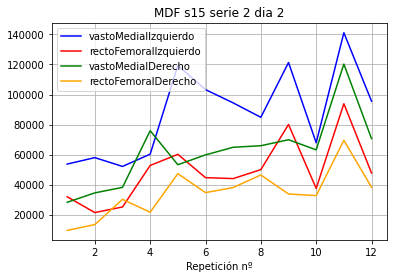

[0 0 0 0 0 0 0 1 1 1 1 1]


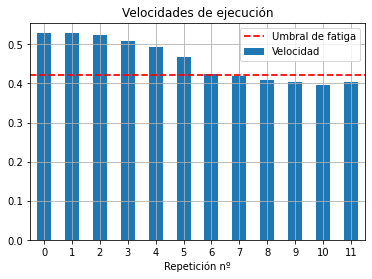

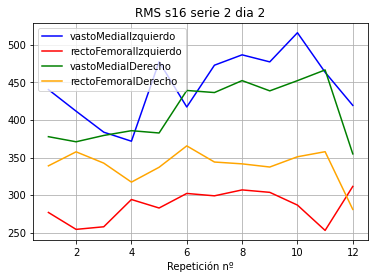

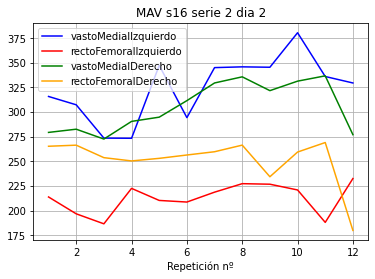

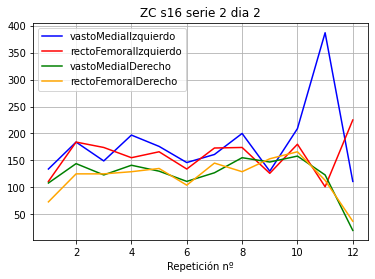

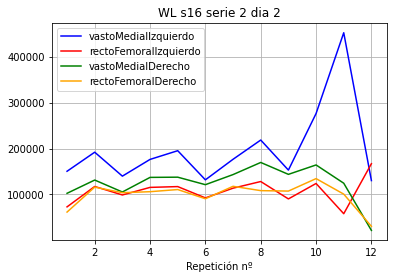

...

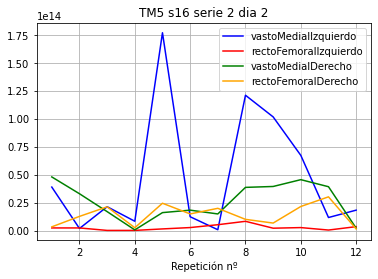

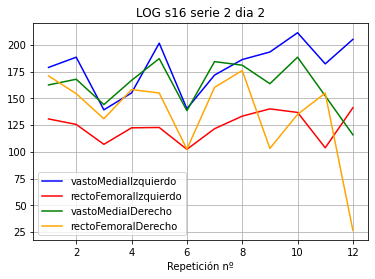

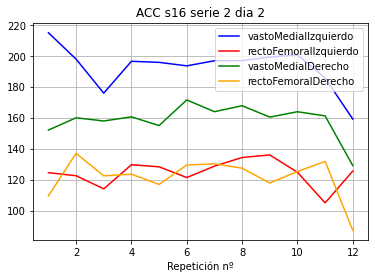

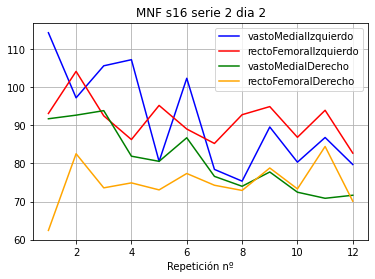

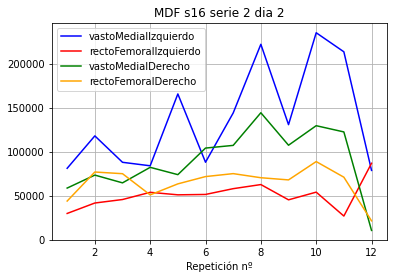

[0 0 0 0 0 0 0 0 0 0 0 0]


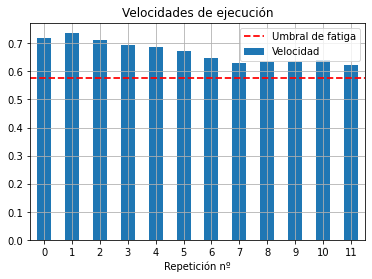

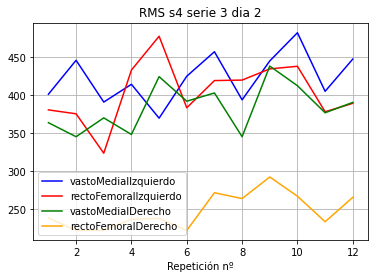

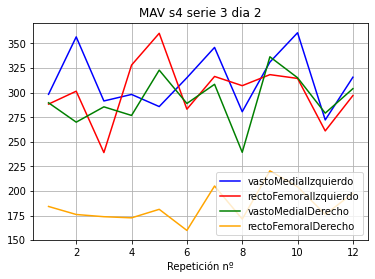

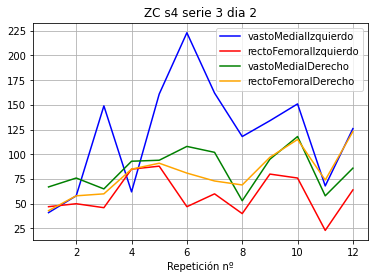

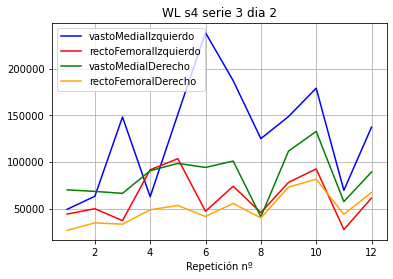

...

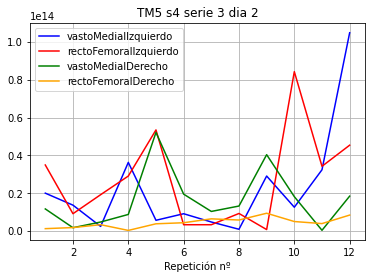

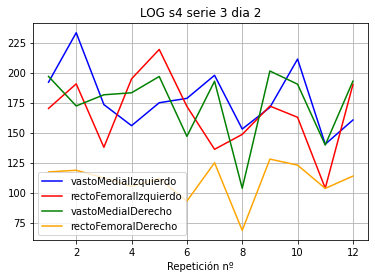

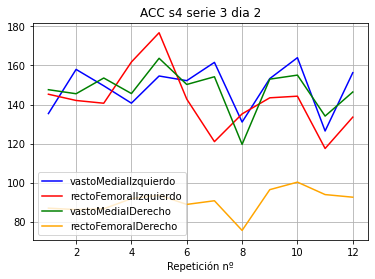

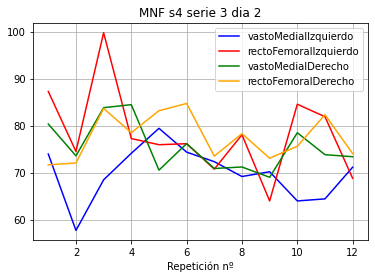

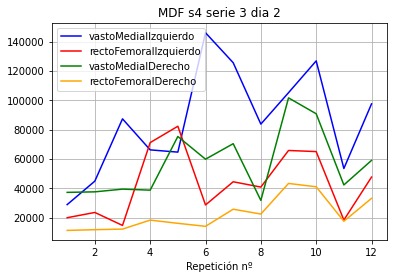

[0 0 0 0 0 0 0 0 0 0 0 0]


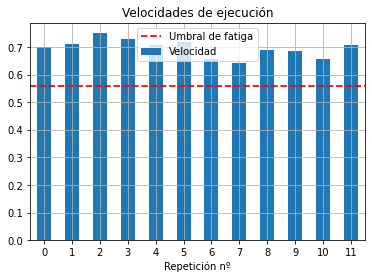

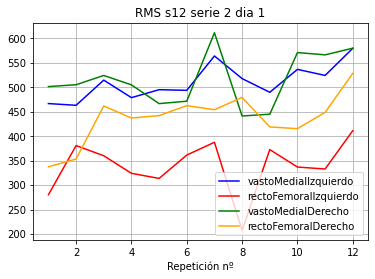

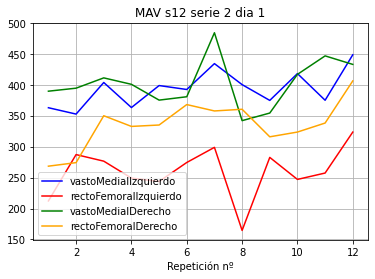

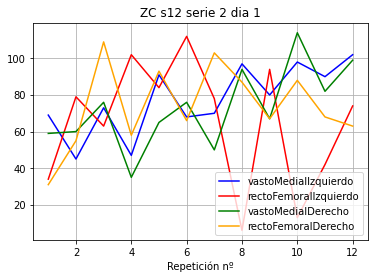

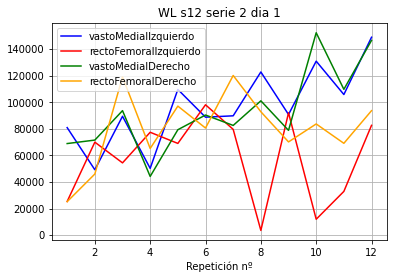

...

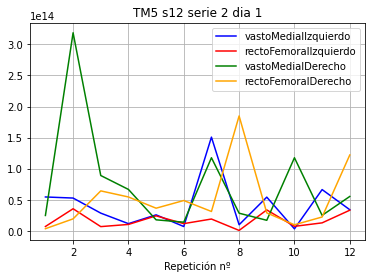

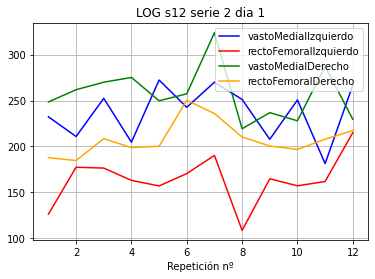

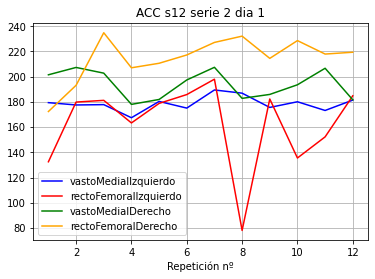

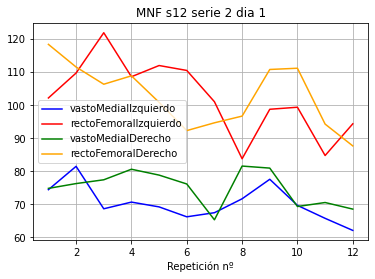

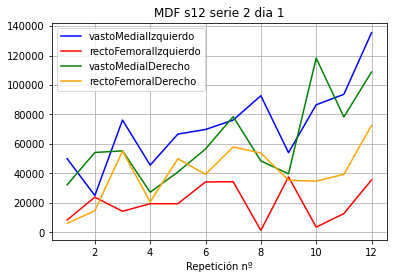

[0 0 0 0 0 0 0 0 0 0 0 0]


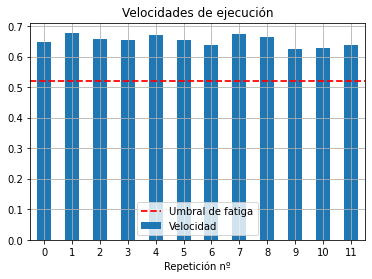

In [9]:
#Ejecución con datos Todas las caracteristicas
fs=1024.0

caracteristicas=['RMS','MAV','ZC','WL','SSC','IEMG','SSI','VAR','TM3','TM4','TM5','LOG','ACC','MNF','MDF']
funciones={'RMS':RMS,'MAV':MAV,'ZC':ZC,'WL':WL,'SSC':SSC,'IEMG':IEMG,'SSI':SSI,'VAR':VAR,'TM3':TM3,
               'TM4':TM4,'TM5':TM5,'LOG':LOG,'ACC':ACC,'MNF':MNF,'MDF':MDF}

obtenerGraficas=True
for archivo in archivosElegidos:
    
    
    df = pd.read_csv(archivo[0],delimiter=";",decimal=",")
    df=df.fillna(0)
    
    
    archivoSinRuta=archivo[0].replace("../Estudio tDCS/","")
    archivoSinRuta=archivoSinRuta.replace(".csv","")
    velocidades=pd.read_excel("../Estudio tDCS/velocidades.xlsx")
    
    velocidad=velocidades[archivoSinRuta]
    
    threshold=archivo[1]
    smooth=archivo[2]
    plot=False

    #1-Obtengo EMG puro 

    #Pierna izquieda
    vastoMedialIzquierdo= df['emg_muscle_1_(µV)'].to_numpy()
    rectoFemoralIzquierdo=df['emg_muscle_2_(µV)'].to_numpy()

    #Pierna derecha
    vastoMedialDerecho=df['emg_muscle_3_(µV)'].to_numpy()
    rectoFemoralDerecho=df['emg_muscle_4_(µV)'].to_numpy()
    
   
    activacion1=bsnb.detect_emg_activations(vastoMedialIzquierdo,fs,smooth_level=smooth, threshold_level=threshold,
                                                time_units=False,volts=False, resolution=None,plot_result=plot)
    
    activacion2=bsnb.detect_emg_activations(rectoFemoralIzquierdo,fs,smooth_level=smooth, threshold_level=threshold,
                                                time_units=False,volts=False, resolution=None,plot_result=plot)
    
    
    activacion3=bsnb.detect_emg_activations(vastoMedialDerecho,fs,smooth_level=smooth, threshold_level=threshold,
                                                time_units=False,volts=False, resolution=None,plot_result=plot)
    
    activacion4=bsnb.detect_emg_activations(rectoFemoralDerecho,fs,smooth_level=smooth, threshold_level=threshold,
                                                time_units=False,volts=False, resolution=None,plot_result=plot)
   

    vmI=[]
    rfI=[]
    vmD=[]
    rfD=[]

    #3- Valores de emg acotados dependiendo de sus activaciones
    #ej: vmI -> lista con los valores EMG de cada repeticion
    for i,j in zip(activacion1[0],activacion1[1]):
        vmI.append(vastoMedialIzquierdo[i:j])

    for i,j in zip(activacion2[0],activacion2[1]):
        rfI.append(rectoFemoralIzquierdo[i:j])

    for i,j in zip(activacion3[0],activacion3[1]):
        vmD.append(vastoMedialDerecho[i:j])

    for i,j in zip(activacion4[0],activacion4[1]):
        rfD.append(rectoFemoralDerecho[i:j])


    
    for caracteristica in caracteristicas:
        ruta="grafica y tablas/"
    
        # A cada archivo EMG (4 señales EMG diferentes = 4 canales) le extraigo una caracteristica  
        dato1=np.array([])
        dato2=np.array([])
        dato3=np.array([])
        dato4=np.array([])
        
        for i,j,k,l in zip(vmI,rfI,vmD,rfD):
            
            x1,y1=funciones[caracteristica](datos=i,ratio=i.size)
            x2,y2=funciones[caracteristica](datos=j,ratio=j.size)
            x3,y3=funciones[caracteristica](datos=k,ratio=k.size)
            x4,y4=funciones[caracteristica](datos=l,ratio=l.size) 
            dato1=np.append(dato1,y1)
            dato2=np.append(dato2,y2)
            dato3=np.append(dato3,y3)
            dato4=np.append(dato4,y4)
            
        plt.title(caracteristica +" " +archivoSinRuta)
        plt.plot(range(1,dato1.size+1),dato1,label="vastoMedialIzquierdo",color="blue")
        plt.plot(range(1,dato2.size+1),dato2,label="rectoFemoralIzquierdo",color="red")
        plt.plot(range(1,dato3.size+1),dato3,label="vastoMedialDerecho",color="green")
        plt.plot(range(1,dato4.size+1),dato4,label="rectoFemoralDerecho",color="orange")
        plt.xlabel("Repetición nº")
        plt.legend()
        plt.grid(True)
        ruta=ruta+ caracteristica +" " +archivoSinRuta+".jpg"
        if (obtenerGraficas == True):
            plt.savefig(ruta)
        plt.show()
    
    
    #Calculos de la fatiga muscular
    fatiga=calculoDeFatiga(velocidad)
    print(fatiga)
    

    plt.title("Velocidades de ejecución")
    velocidad.plot(kind='bar',label="Velocidad",rot=True) 
    plt.axhline(y=velocidad[0]*0.8, xmin=0, xmax=11,linestyle='--',color='red',linewidth=1.75,label="Umbral de fatiga")
    plt.xlabel("Repetición nº")
    plt.legend()
    plt.grid(True)
    plt.show()
    
    obtenerGraficas=False
        
    



# 5. Selección de Características

## 5.1 Procesamiento de datos

In [8]:
def calculoDeFatiga(velocidad):
    fatiga=[]
    
    umbral=0.8*velocidad[0]
    c=0
    for i in range(0,10):
        c=c+1
        if ((velocidad[i] <= umbral) and (velocidad[i+1] <= umbral) ):
            for j in range(i,12):
                fatiga.append(1)
            
            return np.asarray(fatiga)
        
        else:
            fatiga.append(0)
            
        
    if (len(fatiga) != 12):
        if ((velocidad[c] <= umbral) and (velocidad[c+1] <= umbral)):
            for i in range(len(fatiga),12):
                fatiga.append(1)
        else:
            for i in range(len(fatiga),12):
                fatiga.append(0)
    
    return np.asarray(fatiga)

### Datos para canal (1,2,3,4)

In [8]:
def getFeaturesToFileCanal1234():
    
    fs=1024.0
    
    caracteristicas=['RMS','MAV','ZC','WL','SSC','IEMG','SSI','VAR','TM3','TM4','TM5','LOG','ACC','MNF','MDF']
    funciones={'RMS':RMS,'MAV':MAV,'ZC':ZC,'WL':WL,'SSC':SSC,'IEMG':IEMG,'SSI':SSI,'VAR':VAR,'TM3':TM3,
               'TM4':TM4,'TM5':TM5,'LOG':LOG,'ACC':ACC,'MNF':MNF,'MDF':MDF}
    index=[]

    for c in caracteristicas:
        for i in range(0,4):
            index.append(c+str(i+1))
       
    #Cargo las velocidades y creo el vector donde guardo si hay o no fatiga
    velocidades=pd.read_excel("../Estudio tDCS/velocidades.xlsx")
    fatigas=np.array([])
    
    dfC=pd.DataFrame(columns=index)
    
    #Recorro todos los archivos anteriormente elegidos con las 12 repeticiones claras
    indice=0
    for dato in archivosElegidos:
        
        archivo=dato[0]
        threshold=dato[1]
        smooth=dato[2]
        
        archivoSinRuta=archivo.replace("../Estudio tDCS/","")
        archivoSinRuta=archivoSinRuta.replace(".csv","")
        
        
        velocidad=velocidades[archivoSinRuta]
        valoresDeFatiga=calculoDeFatiga(velocidad)
        print(archivoSinRuta)
        print(valoresDeFatiga)
        
        fatigas = np.concatenate((fatigas, valoresDeFatiga))
        
        df = pd.read_csv(archivo,delimiter=";",decimal=",")
        df=df.fillna(0)

        #1-Obtengo EMG puro 
        
        #Pierna izquieda
        vastoMedialIzquierdo= df['emg_muscle_1_(µV)'].to_numpy()
        rectoFemoralIzquierdo=df['emg_muscle_2_(µV)'].to_numpy()

        #Pierna derecha
        vastoMedialDerecho=df['emg_muscle_3_(µV)'].to_numpy()
        rectoFemoralDerecho=df['emg_muscle_4_(µV)'].to_numpy()
        
        
        
        #2-Calculo sus activaciones
        activacion1=bsnb.detect_emg_activations(vastoMedialIzquierdo,fs,smooth_level=smooth, threshold_level=threshold,
                                                    time_units=False,volts=False, resolution=None,plot_result=False)

        activacion2=bsnb.detect_emg_activations(rectoFemoralIzquierdo,fs,smooth_level=smooth, threshold_level=threshold,
                                                    time_units=False,volts=False, resolution=None,plot_result=False)

        activacion3=bsnb.detect_emg_activations(vastoMedialDerecho,fs,smooth_level=smooth, threshold_level=threshold,
                                                    time_units=False,volts=False, resolution=None,plot_result=False)

        activacion4=bsnb.detect_emg_activations(rectoFemoralDerecho,fs,smooth_level=smooth, threshold_level=threshold,
                                                    time_units=False,volts=False, resolution=None,plot_result=False)
        
        
        vmI=[]
        rfI=[]
        vmD=[]
        rfD=[]
        
        #3- Valores de emg acotados dependiendo de sus activaciones
        #ej: vmI -> lista con los valores EMG de cada repeticion
        for i,j in zip(activacion1[0],activacion1[1]):
            vmI.append(vastoMedialIzquierdo[i:j])

        for i,j in zip(activacion2[0],activacion2[1]):
            rfI.append(rectoFemoralIzquierdo[i:j])
            
        for i,j in zip(activacion3[0],activacion3[1]):
            vmD.append(vastoMedialDerecho[i:j])
        
        for i,j in zip(activacion4[0],activacion4[1]):
            rfD.append(rectoFemoralDerecho[i:j])
            
            
        for i,j,k,l in zip(vmI,rfI,vmD,rfD):
            
            # A cada archivo EMG (4 señales EMG diferentes = 4 canales) le extraigo una caracteristica  
            datos=np.array([])
            for caracteristica in caracteristicas:
            
                x1,y1=funciones[caracteristica](datos=i,ratio=i.size)
                x2,y2=funciones[caracteristica](datos=j,ratio=j.size)
                x3,y3=funciones[caracteristica](datos=k,ratio=k.size)
                x4,y4=funciones[caracteristica](datos=l,ratio=l.size)

                #Guardo todos los datos obtenido en un mismo array 
                datos=np.append(datos,y1)
                datos=np.append(datos,y2)
                datos=np.append(datos,y3)
                datos=np.append(datos,y4)
        
            #Añado al final del dataFrame los datos de un archivo (RMS,ARV,......,ZCC)
            dfC.loc[indice]=datos
            indice=indice+1
      
        #print("Log --> Archivo EMG: " + str(archivo) + " \n Archivo velocidad : "+ str(archivoSinRuta) )
        
    dfC['fatiga']=fatigas
              
    
    dfC.to_csv('caracteristicasCanales1234.csv', index = False)
    
    return dfC
        

In [9]:
p=getFeaturesToFileCanal1234()
p

s16 serie 3 dia 1
[0 0 0 0 0 0 0 0 0 0 1 1]
s14 serie 1 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s14 serie 3 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s1 serie 3 dia 1
[0 0 0 0 0 0 1 1 1 1 1 1]
s1 serie 1 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s10 serie 1 dia 1
[0 0 0 0 0 0 0 0 0 0 1 1]
s3 serie 2 dia 1
[0 1 1 1 1 1 1 1 1 1 1 1]
s1 serie 2 dia 1
[0 0 0 0 0 0 0 0 0 1 1 1]
s14 serie 2 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s10 serie 3 dia 1
[0 0 0 0 0 0 0 0 1 1 1 1]
s10 serie 2 dia 1
[0 0 0 0 0 0 0 0 0 1 1 1]
s3 serie 1 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s3 serie 1 dia 2
[0 0 0 0 0 0 0 0 0 0 0 0]
s3 serie 3 dia 1
[0 0 0 0 0 0 0 0 0 1 1 1]
s16 serie 1 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s12 serie 3 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s15 serie 2 dia 2
[0 0 0 0 0 0 0 1 1 1 1 1]
s16 serie 2 dia 2
[0 0 0 0 0 0 0 0 0 0 0 0]
s4 serie 3 dia 2
[0 0 0 0 0 0 0 0 0 0 0 0]
s12 serie 2 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]


,RMS1,RMS2,RMS3,RMS4,MAV1,MAV2,MAV3,MAV4,ZC1,ZC2,...,ACC4,MNF1,MNF2,MNF3,MNF4,MDF1,MDF2,MDF3,MDF4,fatiga
0,202.308487,380.251478,309.256856,270.663726,156.700907,298.434005,246.275335,221.466662,135.0,82.0,...,122.223100,94.948445,74.954321,79.056931,69.726755,14378.841090,49823.546189,24617.082558,6941.910638,0.0
1,187.983354,407.942565,264.127346,374.260304,151.458846,316.530447,212.532032,288.873483,54.0,16.0,...,147.279171,112.400607,79.401837,93.548735,84.279191,4586.185198,3498.945971,15628.225099,22758.470152,0.0
2,185.597510,350.174246,279.030571,367.433944,143.732785,276.186428,220.059068,288.935848,153.0,109.0,...,145.481429,112.115547,86.074758,76.549276,73.981587,12318.821721,46212.084204,23050.919264,40942.106741,0.0
3,191.984262,339.772971,281.644963,380.490081,153.093318,263.874076,228.373151,292.557067,101.0,110.0,...,152.727520,98.661552,89.278637,80.768190,77.953299,8601.907932,43659.721336,22006.410107,54528.252199,0.0
4,196.647206,338.790921,274.432988,390.354309,151.389749,261.255437,218.191146,300.045401,70.0,62.0,...,155.253426,93.486450,88.466056,87.367067,87.171213,9153.988697,23450.586169,20859.203814,48946.040506,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,517.856148,207.349931,441.360876,479.242567,400.880689,164.506067,342.473125,360.915802,97.0,6.0,...,232.163198,71.682280,83.794911,81.577153,96.690188,92722.470180,1240.149179,48410.756709,53800.991805,0.0
236,489.829274,372.670250,444.998076,419.025595,375.294306,282.878471,354.801321,316.267315,80.0,94.0,...,214.526235,77.580343,98.759745,80.962105,110.797101,54032.464267,37603.793757,39669.813937,35322.676984,0.0
237,536.671619,336.965236,571.072252,415.444551,418.778265,247.190545,417.503831,323.986423,98.0,13.0,...,228.622391,69.681238,99.375547,69.346700,111.172698,86554.935983,3482.407108,118279.891543,34707.038962,0.0
238,524.327218,332.921877,566.397040,448.787073,375.543673,257.533755,447.473224,338.593009,90.0,42.0,...,217.949946,65.766867,84.769674,70.553488,94.276549,93672.790868,12677.569651,78292.705818,39348.505216,0.0


### Cargar archivo de datos

In [10]:

valores1234= pd.read_csv("caracteristicasCanales1234.csv",delimiter=",",decimal=".")
caracteristicas=['RMS','MAV','ZC','WL','SSC','IEMG','SSI','VAR','TM3','TM4','TM5','LOG','ACC','MNF','MDF']

#Lista de dataframe con los datos de cada canal
datos1234=[]


#4 canales -> 4 clasificadores
for i in range(1,5):
    datosProcesados=pd.DataFrame()
    for caracteristica in caracteristicas:
        datosProcesados[caracteristica+str(i)]=valores1234[caracteristica+str(i)]
        
        
    
    
    datosProcesados=(datosProcesados-datosProcesados.min())/(datosProcesados.max()-datosProcesados.min())
    datos1234.append(datosProcesados)




In [39]:
datos1234[0]

,RMS1,MAV1,ZC1,WL1,SSC1,IEMG1,SSI1,VAR1,TM31,TM41,TM51,LOG1,ACC1,MNF1,MDF1
0,0.112904,0.119980,0.247642,0.121713,0.207703,0.104327,0.044137,0.054549,0.018561,0.010294,0.004709,0.143275,0.185761,0.493776,0.053499
1,0.079236,0.104212,0.056604,0.024804,0.027510,0.018199,0.007668,0.036963,0.006146,0.003252,0.000325,0.144535,0.208452,0.725863,0.011582
2,0.073628,0.080973,0.290094,0.127078,0.246217,0.094894,0.036376,0.033778,0.024842,0.005307,0.003234,0.093598,0.203427,0.722072,0.044682
3,0.088639,0.109129,0.167453,0.085743,0.177442,0.072766,0.028379,0.041559,0.018394,0.004415,0.001493,0.146326,0.174129,0.543155,0.028772
4,0.099598,0.104005,0.094340,0.046944,0.078404,0.039997,0.017703,0.047487,0.024457,0.006891,0.002948,0.069104,0.162880,0.474334,0.031135
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,0.854534,0.854469,0.158019,0.250640,0.138927,0.305169,0.332004,0.782663,0.040341,0.568737,0.040763,0.858933,0.799262,0.184372,0.388845
236,0.788662,0.777505,0.117925,0.177800,0.103164,0.218261,0.231434,0.692490,0.300248,0.451391,0.212561,0.651600,0.718958,0.262807,0.223235
237,0.898756,0.908304,0.160377,0.269131,0.144429,0.356641,0.396028,0.846101,0.011845,0.656083,0.015448,0.856327,0.750852,0.157761,0.362445
238,0.869743,0.778255,0.141509,0.212002,0.122421,0.262660,0.316159,0.804372,0.207728,0.760044,0.259495,0.525305,0.701828,0.105706,0.392913


In [40]:
datos1234[1]

,RMS2,MAV2,ZC2,WL2,SSC2,IEMG2,SSI2,VAR2,TM32,TM42,TM52,LOG2,ACC2,MNF2,MDF2
0,0.656151,0.706067,0.262987,0.276234,0.269982,0.248293,0.241498,0.561303,0.056133,0.324389,0.100656,0.843027,0.562027,0.229804,0.262619
1,0.754065,0.791986,0.048701,0.030227,0.044405,0.030632,0.032975,0.686202,0.117518,0.365447,0.052510,0.789772,0.555305,0.290502,0.012210
2,0.549799,0.600439,0.350649,0.310575,0.326821,0.244146,0.217111,0.445659,0.100784,0.248669,0.235059,0.792271,0.624996,0.381571,0.243097
3,0.513021,0.541982,0.353896,0.316612,0.314387,0.244722,0.214361,0.407861,0.022106,0.204888,0.000090,0.708345,0.589837,0.425296,0.229300
4,0.509548,0.529549,0.198052,0.151513,0.168739,0.117578,0.103214,0.405340,0.072416,0.222494,0.132670,0.681840,0.574897,0.414206,0.120059
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,0.044781,0.070199,0.016234,0.003420,0.030195,0.005083,0.000000,0.031545,0.057323,0.000544,0.016962,0.420192,0.000000,0.350456,0.000000
236,0.629344,0.632212,0.301948,0.303014,0.227353,0.212890,0.209927,0.531407,0.244827,0.342145,0.388273,0.691009,0.799417,0.554691,0.196565
237,0.503093,0.462771,0.038961,0.031878,0.047957,0.027098,0.024801,0.403758,0.126997,0.244395,0.090743,0.654181,0.440487,0.563095,0.012121
238,0.488796,0.511879,0.133117,0.102802,0.106572,0.079068,0.067736,0.385387,0.121981,0.195079,0.153846,0.676894,0.568990,0.363760,0.061825


In [41]:
datos1234[2]

,RMS3,MAV3,ZC3,WL3,SSC3,IEMG3,SSI3,VAR3,TM33,TM43,TM53,LOG3,ACC3,MNF3,MDF3
0,0.202019,0.278990,0.184751,0.185926,0.243137,0.178085,0.111246,0.124366,0.059454,0.034726,0.009183,0.450954,0.386822,0.366914,0.097596
1,0.094376,0.186980,0.199413,0.160139,0.241176,0.128308,0.061633,0.053289,0.043570,0.008802,0.004694,0.374717,0.381884,0.607616,0.050680
2,0.129923,0.207505,0.222874,0.186321,0.296078,0.155355,0.084976,0.075494,0.056514,0.019244,0.001773,0.395575,0.383250,0.325263,0.089421
3,0.136159,0.230175,0.219941,0.189860,0.278431,0.170055,0.091307,0.079509,0.059556,0.012561,0.005880,0.411540,0.366598,0.395337,0.083970
4,0.118957,0.202411,0.184751,0.155681,0.217647,0.126557,0.065540,0.068562,0.007787,0.015892,0.001329,0.386440,0.396121,0.504941,0.077982
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,0.517115,0.541296,0.217009,0.308270,0.186275,0.280428,0.275449,0.396840,0.131149,0.235814,0.091268,0.635039,0.758649,0.408774,0.221782
236,0.525790,0.574912,0.137830,0.226518,0.115686,0.213264,0.207266,0.406000,0.087467,0.203525,0.055567,0.693302,0.780025,0.398558,0.176160
237,0.826504,0.745886,0.275660,0.496561,0.274510,0.520428,0.702798,0.757245,0.382280,0.720956,0.370588,0.663935,0.832282,0.205631,0.586450
238,0.815352,0.827605,0.181818,0.340074,0.164706,0.363574,0.455139,0.743180,0.309736,0.504719,0.080444,0.861531,0.921794,0.225676,0.377745


In [42]:
datos1234[3]

,RMS4,MAV4,ZC4,WL4,SSC4,IEMG4,SSI4,VAR4,TM34,TM44,TM54,LOG4,ACC4,MNF4,MDF4
0,0.321700,0.381434,0.057971,0.024686,0.060150,0.028066,0.011039,0.196557,0.009532,0.032117,0.003713,0.565544,0.243505,0.093000,0.019498
1,0.583835,0.606285,0.156522,0.130127,0.193609,0.146520,0.123554,0.443685,0.066575,0.178326,0.017072,0.685424,0.366326,0.277962,0.085912
2,0.566562,0.606493,0.150725,0.161611,0.236842,0.183139,0.147511,0.424655,0.036820,0.172638,0.012693,0.734083,0.357513,0.147079,0.162266
3,0.599598,0.618573,0.220290,0.222784,0.280075,0.240195,0.205569,0.460669,0.077898,0.189877,0.045925,0.705786,0.393032,0.197560,0.219315
4,0.624558,0.643552,0.197101,0.182469,0.221805,0.199673,0.176400,0.489085,0.011955,0.254499,0.036450,0.754263,0.405414,0.314720,0.195875
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,0.849475,0.846600,0.223188,0.232775,0.178571,0.198336,0.224703,0.776370,0.356692,0.665043,0.630130,0.821365,0.782413,0.435706,0.216261
236,0.697106,0.697664,0.165217,0.168298,0.152256,0.134332,0.132853,0.575870,0.034169,0.358029,0.100081,0.777748,0.695960,0.615006,0.138670
237,0.688045,0.723413,0.226087,0.206691,0.208647,0.158028,0.148193,0.564558,0.000612,0.298027,0.035190,0.760997,0.765057,0.619780,0.136085
238,0.772412,0.772137,0.168116,0.165289,0.154135,0.140451,0.149999,0.671905,0.066700,0.440023,0.077779,0.810293,0.712742,0.405029,0.155575


### Datos para canal (1,2)

In [11]:
valores1234= pd.read_csv("caracteristicasCanales1234.csv",delimiter=",",decimal=".")
caracteristicas=['RMS','MAV','ZC','WL','SSC','IEMG','SSI','VAR','TM3','TM4','TM5','LOG','ACC','MNF','MDF']

valores12=pd.DataFrame()
for c in caracteristicas:
    g=np.array([])
    for i in range(1,3):
        g=np.append(g,valores1234[c+str(i)].values)
    
    valores12[c]=g
        

valores12=(valores12-valores12.min())/(valores12.max()-valores12.min())

fatiga=np.array(valores1234['fatiga'])

fatiga=np.append(fatiga,valores1234['fatiga'])

valores12['fatiga']=fatiga

valores12

,RMS,MAV,ZC,WL,SSC,IEMG,SSI,VAR,TM3,TM4,TM5,LOG,ACC,MNF,MDF,fatiga
0,0.112904,0.119980,0.295806,0.141514,0.259640,0.121682,0.048013,0.054549,0.016006,0.010294,0.004932,0.308502,0.185761,0.493776,0.056086,0.0
1,0.079236,0.104212,0.116998,0.046790,0.091260,0.037224,0.011692,0.036963,0.005408,0.003252,0.000549,0.309520,0.208452,0.725863,0.014283,0.0
2,0.073628,0.080973,0.335541,0.146758,0.295630,0.112433,0.040283,0.033778,0.021368,0.005307,0.003457,0.268406,0.203427,0.722072,0.047292,0.0
3,0.088639,0.109129,0.220751,0.106355,0.231362,0.090733,0.032319,0.041559,0.015864,0.004415,0.001717,0.310965,0.174129,0.543155,0.031426,0.0
4,0.099598,0.104005,0.152318,0.068430,0.138817,0.058599,0.021687,0.047487,0.021040,0.006891,0.003172,0.248636,0.162880,0.474334,0.033782,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
475,0.124753,0.143458,0.011038,0.002248,0.021851,0.004071,0.000000,0.064083,0.057323,0.008325,0.005821,0.336262,0.026267,0.345451,0.000000,0.0
476,0.513304,0.499520,0.205298,0.199163,0.164524,0.170523,0.131001,0.368607,0.244827,0.171450,0.133236,0.552985,0.766456,0.544460,0.155227,0.0
477,0.429387,0.392172,0.026490,0.020952,0.034704,0.021705,0.015476,0.290841,0.126997,0.124772,0.031138,0.523513,0.434119,0.552650,0.009572,0.0
478,0.419884,0.423284,0.090508,0.067569,0.077121,0.063333,0.042269,0.279649,0.121981,0.101222,0.052792,0.541689,0.553101,0.358414,0.048824,0.0


### Datos para canal (3,4)

In [12]:
valores1234= pd.read_csv("caracteristicasCanales1234.csv",delimiter=",",decimal=".")
caracteristicas=['RMS','MAV','ZC','WL','SSC','IEMG','SSI','VAR','TM3','TM4','TM5','LOG','ACC','MNF','MDF']

valores34=pd.DataFrame()
for c in caracteristicas:
    g=np.array([])
    for i in range(3,5):
        g=np.append(g,valores1234[c+str(i)].values)
    
    valores34[c]=g
        


valores34=(valores34-valores34.min())/(valores34.max()-valores34.min())

fatiga=np.array(valores1234['fatiga'])

fatiga=np.append(fatiga,valores1234['fatiga'])

valores34['fatiga']=fatiga

valores34

,RMS,MAV,ZC,WL,SSC,IEMG,SSI,VAR,TM3,TM4,TM5,LOG,ACC,MNF,MDF,fatiga
0,0.331273,0.344806,0.207977,0.161583,0.270677,0.175932,0.114412,0.190592,0.023537,0.046408,0.009183,0.454697,0.276464,0.262604,0.093717,0.0
1,0.241065,0.261196,0.222222,0.141657,0.268797,0.130809,0.068317,0.124890,0.017248,0.020797,0.004694,0.378979,0.272934,0.434877,0.055972,0.0
2,0.270855,0.279847,0.245014,0.161888,0.321429,0.155328,0.090005,0.145416,0.022373,0.031113,0.001773,0.399695,0.273911,0.232794,0.087140,0.0
3,0.276080,0.300448,0.242165,0.164623,0.304511,0.168654,0.095887,0.149127,0.023577,0.024510,0.005880,0.415551,0.262009,0.282946,0.082755,0.0
4,0.261665,0.275218,0.207977,0.138212,0.246241,0.129222,0.071947,0.139008,0.003083,0.027801,0.001329,0.390622,0.283110,0.361391,0.077937,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
475,0.671051,0.628867,0.219373,0.232775,0.178571,0.198336,0.224703,0.531451,0.357004,0.400919,0.581064,0.607766,0.783246,0.472221,0.216261,0.0
476,0.550686,0.518235,0.162393,0.168298,0.152256,0.134332,0.132853,0.394202,0.034637,0.215837,0.092755,0.575491,0.697124,0.639918,0.138670,0.0
477,0.543528,0.537362,0.222222,0.206691,0.208647,0.158028,0.148193,0.386458,0.001096,0.179664,0.032974,0.563097,0.765956,0.644383,0.136085,0.0
478,0.610175,0.573554,0.165242,0.165289,0.154135,0.140451,0.149999,0.459941,0.067152,0.265266,0.072210,0.599573,0.713842,0.443529,0.155575,0.0


### Datos Totales

In [13]:
def getFeaturesToFileTotales():
    
    fs=1024.0
    
    caracteristicas=['RMS','MAV','ZC','WL','SSC','IEMG','SSI','VAR','TM3','TM4','TM5','LOG','ACC','MNF','MDF']
    funciones={'RMS':RMS,'MAV':MAV,'ZC':ZC,'WL':WL,'SSC':SSC,'IEMG':IEMG,'SSI':SSI,'VAR':VAR,'TM3':TM3,
               'TM4':TM4,'TM5':TM5,'LOG':LOG,'ACC':ACC,'MNF':MNF,'MDF':MDF}
       
    #Cargo las velocidades y creo el vector donde guardo si hay o no fatiga
    velocidades=pd.read_excel("../Estudio tDCS/velocidades.xlsx")
    
    
    dfC=pd.DataFrame()
    
    #Recorro todos los archivos anteriormente elegidos con las 12 repeticiones claras
    indice=0
    for dato in archivosElegidos:
        
        archivo=dato[0]
        threshold=dato[1]
        smooth=dato[2]
        
        archivoSinRuta=archivo.replace("../Estudio tDCS/","")
        archivoSinRuta=archivoSinRuta.replace(".csv","")
        
        
        velocidad=velocidades[archivoSinRuta]
        valoresDeFatiga=calculoDeFatiga(velocidad)
        
        
        fatigas=np.array([])
        fatigas = np.concatenate((fatigas, valoresDeFatiga))
        fatigas = np.concatenate((fatigas, valoresDeFatiga))
        fatigas = np.concatenate((fatigas, valoresDeFatiga))
        fatigas = np.concatenate((fatigas, valoresDeFatiga))
        
        print(archivoSinRuta)
        print(valoresDeFatiga)
        
        df = pd.read_csv(archivo,delimiter=";",decimal=",")
        df=df.fillna(0)

        #1-Obtengo EMG puro 
        
        #Pierna izquieda
        vastoMedialIzquierdo= df['emg_muscle_1_(µV)'].to_numpy()
        rectoFemoralIzquierdo=df['emg_muscle_2_(µV)'].to_numpy()

        #Pierna derecha
        vastoMedialDerecho=df['emg_muscle_3_(µV)'].to_numpy()
        rectoFemoralDerecho=df['emg_muscle_4_(µV)'].to_numpy()
        
        
        
        #2-Calculo sus activaciones
        activacion1=bsnb.detect_emg_activations(vastoMedialIzquierdo,fs,smooth_level=smooth, threshold_level=threshold,
                                                    time_units=False,volts=False, resolution=None,plot_result=False)

        activacion2=bsnb.detect_emg_activations(rectoFemoralIzquierdo,fs,smooth_level=smooth, threshold_level=threshold,
                                                    time_units=False,volts=False, resolution=None,plot_result=False)

        activacion3=bsnb.detect_emg_activations(vastoMedialDerecho,fs,smooth_level=smooth, threshold_level=threshold,
                                                    time_units=False,volts=False, resolution=None,plot_result=False)

        activacion4=bsnb.detect_emg_activations(rectoFemoralDerecho,fs,smooth_level=smooth, threshold_level=threshold,
                                                    time_units=False,volts=False, resolution=None,plot_result=False)
        
        
        vmI=[]
        rfI=[]
        vmD=[]
        rfD=[]
        
        #3- Valores de emg acotados dependiendo de sus activaciones
        #ej: vmI -> lista con los valores EMG de cada repeticion
        for i,j in zip(activacion1[0],activacion1[1]):
            vmI.append(vastoMedialIzquierdo[i:j])

        for i,j in zip(activacion2[0],activacion2[1]):
            rfI.append(rectoFemoralIzquierdo[i:j])
            
        for i,j in zip(activacion3[0],activacion3[1]):
            vmD.append(vastoMedialDerecho[i:j])
        
        for i,j in zip(activacion4[0],activacion4[1]):
            rfD.append(rectoFemoralDerecho[i:j])
        
        
        
        dfCcaracteristica=pd.DataFrame()
        for caracteristica in caracteristicas:
            
            
            datos=np.array([])
            for i in vmI:
                x1,y1=funciones[caracteristica](datos=i,ratio=i.size)
                datos=np.append(datos,y1)
                
            for j in rfI:
                x2,y2=funciones[caracteristica](datos=j,ratio=j.size)
                datos=np.append(datos,y2)
                
            for k in vmD:
                x3,y3=funciones[caracteristica](datos=k,ratio=k.size)
                datos=np.append(datos,y3)
                
            for l in rfD:
                x4,y4=funciones[caracteristica](datos=l,ratio=l.size)
                datos=np.append(datos,y4)
                
                
            dfCcaracteristica[caracteristica]=datos
            
        
        
        dfCcaracteristica['fatiga']=fatigas
        dfC=pd.concat([dfC, dfCcaracteristica], ignore_index=False)
             
                
    
    dfC.to_csv('caracteristicasTotales.csv', index = False)
    
    return dfC

In [14]:
getFeaturesToFileTotales()

s16 serie 3 dia 1
[0 0 0 0 0 0 0 0 0 0 1 1]
s14 serie 1 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s14 serie 3 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s1 serie 3 dia 1
[0 0 0 0 0 0 1 1 1 1 1 1]
s1 serie 1 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s10 serie 1 dia 1
[0 0 0 0 0 0 0 0 0 0 1 1]
s3 serie 2 dia 1
[0 1 1 1 1 1 1 1 1 1 1 1]
s1 serie 2 dia 1
[0 0 0 0 0 0 0 0 0 1 1 1]
s14 serie 2 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s10 serie 3 dia 1
[0 0 0 0 0 0 0 0 1 1 1 1]
s10 serie 2 dia 1
[0 0 0 0 0 0 0 0 0 1 1 1]
s3 serie 1 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s3 serie 1 dia 2
[0 0 0 0 0 0 0 0 0 0 0 0]
s3 serie 3 dia 1
[0 0 0 0 0 0 0 0 0 1 1 1]
s16 serie 1 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s12 serie 3 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]
s15 serie 2 dia 2
[0 0 0 0 0 0 0 1 1 1 1 1]
s16 serie 2 dia 2
[0 0 0 0 0 0 0 0 0 0 0 0]
s4 serie 3 dia 2
[0 0 0 0 0 0 0 0 0 0 0 0]
s12 serie 2 dia 1
[0 0 0 0 0 0 0 0 0 0 0 0]


,RMS,MAV,ZC,WL,SSC,IEMG,SSI,VAR,TM3,TM4,TM5,LOG,ACC,MNF,MDF,fatiga
0,202.308487,156.700907,135.0,66138.359,204.0,103109.197,2.693110e+07,40991.020428,1.782625e+06,6.211790e+09,1.273148e+12,101.339219,100.514223,94.948445,14378.841090,0.0
1,187.983354,151.458846,54.0,23542.215,73.0,34381.158,8.021667e+06,35494.103150,6.207434e+05,3.392125e+09,1.427202e+11,101.603315,103.710198,112.400607,4586.185198,0.0
2,185.597510,143.732785,153.0,68496.631,232.0,95582.302,2.290688e+07,34498.313006,2.370453e+06,4.215049e+09,8.927286e+11,90.931057,103.002453,112.115547,12318.821721,0.0
3,191.984262,153.093318,101.0,50327.844,182.0,77924.499,1.876070e+07,36930.511700,1.767045e+06,3.858039e+09,4.439128e+11,101.978580,98.875921,98.661552,8601.907932,0.0
4,196.647206,151.389749,70.0,33273.709,110.0,51775.294,1.322518e+07,38783.525622,2.334464e+06,4.849117e+09,8.191247e+11,85.799017,97.291547,93.486450,9153.988697,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43,479.242567,360.915802,87.0,92865.279,112.0,144366.321,9.186938e+07,230249.060261,6.129332e+07,2.297822e+11,1.850249e+14,210.348044,232.163198,96.690188,53800.991805,0.0
44,419.025595,316.267315,67.0,70150.079,98.0,103419.412,5.741546e+07,176121.046145,5.974516e+06,1.245755e+11,2.956703e+13,200.590448,214.526235,110.797101,35322.676984,0.0
45,415.444551,323.986423,88.0,83675.795,128.0,118579.031,6.316947e+07,173067.035538,2.188062e+05,1.040140e+11,1.053512e+13,196.843188,228.622391,111.172698,34707.038962,0.0
46,448.787073,338.593009,68.0,69090.133,99.0,107333.984,6.384692e+07,202047.209981,1.155405e+07,1.526728e+11,2.302610e+13,207.871167,217.949946,94.276549,39348.505216,0.0


### Cargar archivo de datos

In [15]:

valoresTotales= pd.read_csv("caracteristicasTotales.csv",delimiter=",",decimal=".")


datosTotales=valoresTotales.drop(['fatiga'],axis=1)

datosTotales=(datosTotales-datosTotales.min())/(datosTotales.max()-datosTotales.min())

datosTotales


,RMS,MAV,ZC,WL,SSC,IEMG,SSI,VAR,TM3,TM4,TM5,LOG,ACC,MNF,MDF
0,0.117498,0.122856,0.295806,0.141514,0.259640,0.121682,0.048013,0.051562,0.010226,0.007608,0.003995,0.260279,0.140395,0.451516,0.054926
1,0.088864,0.109867,0.116998,0.046790,0.091260,0.037224,0.011692,0.037624,0.003455,0.002648,0.000444,0.261137,0.156002,0.658980,0.013988
2,0.084095,0.090723,0.335541,0.146758,0.295630,0.112433,0.040283,0.035099,0.013651,0.004096,0.002800,0.226450,0.152546,0.655592,0.046314
3,0.096861,0.113917,0.220751,0.106355,0.231362,0.090733,0.032319,0.041266,0.010135,0.003468,0.001390,0.262357,0.132395,0.495656,0.030775
4,0.106182,0.109696,0.152318,0.068430,0.138817,0.058599,0.021687,0.045965,0.013441,0.005211,0.002569,0.209770,0.124659,0.434136,0.033083
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
955,0.671051,0.628867,0.189845,0.200948,0.141388,0.172382,0.172747,0.531451,0.357014,0.400919,0.581112,0.614578,0.783246,0.472221,0.219728
956,0.550686,0.518235,0.145695,0.150435,0.123393,0.122064,0.106568,0.394202,0.034653,0.215837,0.092859,0.582864,0.697124,0.639918,0.142480
957,0.543528,0.537362,0.192053,0.180513,0.161954,0.140693,0.117620,0.386458,0.001113,0.179664,0.033084,0.570684,0.765956,0.644383,0.139907
958,0.610175,0.573554,0.147903,0.148078,0.124679,0.126874,0.118921,0.459941,0.067167,0.265266,0.072315,0.606527,0.713842,0.443529,0.159310


## 5.2 Recursive Feature Elimination

### RFE para dataset completo N=1,2,5

In [43]:
caracteristicas=['RMS','MAV','ZC','WL','SSC','IEMG','SSI','VAR','TM3','TM4','TM5','LOG','ACC','MNF','MDF']
numeroCaracteristicas=[1,2,5]

RFEcompleto=[]

for i in numeroCaracteristicas:

    
    
    x = datosTotales.to_numpy()
    y = valoresTotales['fatiga'].to_numpy()

    estimator= SVC(kernel='linear')

    selector= RFECV(estimator,step=1,cv=15,min_features_to_select=i)
    selector=selector.fit(x,y)
    ni=np.array(selector.support_)

    pi=pd.DataFrame(data=ni,columns=['Validez'])

    pi['Caracteristica']=caracteristicas

    pi = pi.drop(pi[pi.Validez == False].index)

    
    print("N= " + str(i))
    print(pi)
    print("\n\n")


    datosFinalesTotales=pd.DataFrame()
    for caracteristica in pi['Caracteristica']:
        datosFinalesTotales[caracteristica]=datosTotales[caracteristica]


    RFEcompleto.append(datosFinalesTotales)


N= 1
   Validez Caracteristica
5     True           IEMG



N= 2
   Validez Caracteristica
5     True           IEMG
6     True            SSI



N= 5
   Validez Caracteristica
0     True            RMS
3     True             WL
4     True            SSC
5     True           IEMG
6     True            SSI





In [21]:
RFEcompleto

[         IEMG
 0    0.121682
 1    0.037224
 2    0.112433
 3    0.090733
 4    0.058599
 ..        ...
 955  0.172382
 956  0.122064
 957  0.140693
 958  0.126874
 959  0.208488
 
 [960 rows x 1 columns],
          IEMG       SSI
 0    0.121682  0.048013
 1    0.037224  0.011692
 2    0.112433  0.040283
 3    0.090733  0.032319
 4    0.058599  0.021687
 ..        ...       ...
 955  0.172382  0.172747
 956  0.122064  0.106568
 957  0.140693  0.117620
 958  0.126874  0.118921
 959  0.208488  0.225372
 
 [960 rows x 2 columns],
           RMS        WL       SSC      IEMG       SSI
 0    0.117498  0.141514  0.259640  0.121682  0.048013
 1    0.088864  0.046790  0.091260  0.037224  0.011692
 2    0.084095  0.146758  0.295630  0.112433  0.040283
 3    0.096861  0.106355  0.231362  0.090733  0.032319
 4    0.106182  0.068430  0.138817  0.058599  0.021687
 ..        ...       ...       ...       ...       ...
 955  0.671051  0.200948  0.141388  0.172382  0.172747
 956  0.550686  0.150435  

### RFE para cada canal (1,2,3,4) N= 1,2,5

In [44]:

caracteristicas=['RMS','MAV','ZC','WL','SSC','IEMG','SSI','VAR','TM3','TM4','TM5','LOG','ACC','MNF','MDF']
#[0] -> N=1 canal 1
#[1] -> N=1 canal 2
#[2] -> N=1 canal 3
#[3] -> N=1 canal 4

#[4] -> N=2 canal 1
#[5] -> N=2 canal 2
#[6] -> N=2 canal 3
#[7] -> N=2 canal 4

listaDeAtributos=[]
numeroCaracteristicas=[1,2,5]


for i in numeroCaracteristicas:
    canal=1
    #Recorro la lista con los valores de los 4 canales
    for dato in datos1234:

        x=dato.to_numpy()
        y=valores1234['fatiga'].to_numpy()

        
        estimator = SVC(kernel="linear")
    
        print("N = " + str(i) + " ------------------------------------------------")
        print("estimacion canal : " + str(canal))

        selector= RFECV(estimator,step=1,cv=15,min_features_to_select=i)
        selector=selector.fit(x,y)

        ni=np.array(selector.support_)
        pi=pd.DataFrame(data=ni,columns=['Validez'])

        pi['Caracteristica']=caracteristicas
        pi['canal']=canal
        pi = pi.drop(pi[pi.Validez == False].index)

        print(pi)
        print("\n\n")

        listaDeAtributos.append(pi['Caracteristica'])
        #listaDeAtributos.append(pi)

        canal=canal+1

#obtengo el dataset para cada clasificador
datosFinales1234=[]

i=0
for caracteristicas in listaDeAtributos:
    if (i > 3):
        i=0
        
    p=pd.DataFrame()
    for caracteristica in caracteristicas:
        p[caracteristica + str(i+1)]=valores1234[caracteristica + str(i+1)]
    i=i+1

    p=(p-p.min())/(p.max()-p.min())
    datosFinales1234.append(p)




N = 1 ------------------------------------------------
estimacion canal : 1
   Validez Caracteristica  canal
5     True           IEMG      1



N = 1 ------------------------------------------------
estimacion canal : 2
   Validez Caracteristica  canal
5     True           IEMG      2



N = 1 ------------------------------------------------
estimacion canal : 3
   Validez Caracteristica  canal
0     True            RMS      3



N = 1 ------------------------------------------------
estimacion canal : 4
    Validez Caracteristica  canal
14     True            MDF      4



N = 2 ------------------------------------------------
estimacion canal : 1
   Validez Caracteristica  canal
3     True             WL      1
5     True           IEMG      1



N = 2 ------------------------------------------------
estimacion canal : 2
    Validez Caracteristica  canal
5      True           IEMG      2
14     True            MDF      2



N = 2 ------------------------------------------------
esti

### RFE para  canal (1,2) N= 1,2,5

In [45]:
caracteristicas=['RMS','MAV','ZC','WL','SSC','IEMG','SSI','VAR','TM3','TM4','TM5','LOG','ACC','MNF','MDF']

numeroCaracteristicas=[1,2,5]

RFEcanal12=[]



for i in numeroCaracteristicas:
    
    
    x = valores12.drop(['fatiga'],axis=1).to_numpy()
    y = valores12['fatiga'].to_numpy()

    estimator= SVC(kernel='linear')

    selector= RFECV(estimator,step=1,cv=15,min_features_to_select=i)
    selector=selector.fit(x,y)
    ni=np.array(selector.support_)

    pi=pd.DataFrame(data=ni,columns=['Validez'])

    pi['Caracteristica']=caracteristicas

    pi = pi.drop(pi[pi.Validez == False].index)

    
    print("N= " + str(i))
    print(pi)
    print("\n\n")


    datosFinalesTotales=pd.DataFrame()
    for caracteristica in pi['Caracteristica']:
        datosFinalesTotales[caracteristica]=valores12[caracteristica]


    RFEcanal12.append(datosFinalesTotales)


RFEcanal12

N= 1
   Validez Caracteristica
0     True            RMS



N= 2
   Validez Caracteristica
0     True            RMS
7     True            VAR



N= 5
    Validez Caracteristica
0      True            RMS
5      True           IEMG
7      True            VAR
9      True            TM4
10     True            TM5





[          RMS
 0    0.112904
 1    0.079236
 2    0.073628
 3    0.088639
 4    0.099598
 ..        ...
 475  0.124753
 476  0.513304
 477  0.429387
 478  0.419884
 479  0.604293
 
 [480 rows x 1 columns],
           RMS       VAR
 0    0.112904  0.054549
 1    0.079236  0.036963
 2    0.073628  0.033778
 3    0.088639  0.041559
 4    0.099598  0.047487
 ..        ...       ...
 475  0.124753  0.064083
 476  0.513304  0.368607
 477  0.429387  0.290841
 478  0.419884  0.279649
 479  0.604293  0.466047
 
 [480 rows x 2 columns],
           RMS      IEMG       VAR       TM4       TM5
 0    0.112904  0.121682  0.054549  0.010294  0.004932
 1    0.079236  0.037224  0.036963  0.003252  0.000549
 2    0.073628  0.112433  0.033778  0.005307  0.003457
 3    0.088639  0.090733  0.041559  0.004415  0.001717
 4    0.099598  0.058599  0.047487  0.006891  0.003172
 ..        ...       ...       ...       ...       ...
 475  0.124753  0.004071  0.064083  0.008325  0.005821
 476  0.513304  0.170523  

### RFE para  canal (3,4) N= 1,2,5

In [46]:
caracteristicas=['RMS','MAV','ZC','WL','SSC','IEMG','SSI','VAR','TM3','TM4','TM5','LOG','ACC','MNF','MDF']

numeroCaracteristicas=[1,2,5]

RFEcanal34=[]

for i in numeroCaracteristicas:
    
    x = valores34.drop(['fatiga'],axis=1).to_numpy()
    y = valores34['fatiga'].to_numpy()

    estimator= SVC(kernel='linear')

    selector= RFECV(estimator,step=1,cv=15,min_features_to_select=i)
    selector=selector.fit(x,y)
    ni=np.array(selector.support_)

    pi=pd.DataFrame(data=ni,columns=['Validez'])

    pi['Caracteristica']=caracteristicas

    pi = pi.drop(pi[pi.Validez == False].index)

    
    print("N= " + str(i))
    print(pi)
    print("\n\n")

    
    datosFinalesTotales=pd.DataFrame()
    for caracteristica in pi['Caracteristica']:
        datosFinalesTotales[caracteristica]=valores34[caracteristica]


    RFEcanal34.append(datosFinalesTotales)


RFEcanal34

N= 1
   Validez Caracteristica
0     True            RMS



N= 2
   Validez Caracteristica
0     True            RMS
7     True            VAR



N= 5
    Validez Caracteristica
0      True            RMS
1      True            MAV
6      True            SSI
7      True            VAR
14     True            MDF





[          RMS
 0    0.331273
 1    0.241065
 2    0.270855
 3    0.276080
 4    0.261665
 ..        ...
 475  0.671051
 476  0.550686
 477  0.543528
 478  0.610175
 479  0.769511
 
 [480 rows x 1 columns],
           RMS       VAR
 0    0.331273  0.190592
 1    0.241065  0.124890
 2    0.270855  0.145416
 3    0.276080  0.149127
 4    0.261665  0.139008
 ..        ...       ...
 475  0.671051  0.531451
 476  0.550686  0.394202
 477  0.543528  0.386458
 478  0.610175  0.459941
 479  0.769511  0.657521
 
 [480 rows x 2 columns],
           RMS       MAV       SSI       VAR       MDF
 0    0.331273  0.344806  0.114412  0.190592  0.093717
 1    0.241065  0.261196  0.068317  0.124890  0.055972
 2    0.270855  0.279847  0.090005  0.145416  0.087140
 3    0.276080  0.300448  0.095887  0.149127  0.082755
 4    0.261665  0.275218  0.071947  0.139008  0.077937
 ..        ...       ...       ...       ...       ...
 475  0.671051  0.628867  0.224703  0.531451  0.216261
 476  0.550686  0.518235  

# 5. Clasificación de señales EMG 

In [118]:
graficasTipoClasificador=[]
graficasTipoCanal=[]


numeroCaracteristicas=['N=1', 'N=2','N=5']
clasificadores=['SVM','TREE','KNN']


graficaCanal1=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)
graficaCanal2=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)
graficaCanal3=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)
graficaCanal4=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)
graficaCanalTotal=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)
graficaCanal12=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)
graficaCanal34=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)


graficaCanal1Desviacion=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)
graficaCanal2Desviacion=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)
graficaCanal3Desviacion=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)
graficaCanal4Desviacion=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)
graficaCanalTotalDesviacion=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)
graficaCanal12Desviacion=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)
graficaCanal34Desviacion=pd.DataFrame(index=clasificadores,columns=numeroCaracteristicas)




## 5.1 Support Vector Machines (SVMs)

In [119]:
numeroCaracteristicas=['N=1', 'N=2','N=5']
canales=['canal 1','canal 2','canal 3','canal 4','canal Total','canal 1,2','canal 3,4']

graficaSVM=pd.DataFrame(index=canales,columns=numeroCaracteristicas)



### 5.1.1 SVM Total

In [120]:
canal='canal Total'

for dato in RFEcompleto:
    
    print("N = " + str(len(dato.columns)) + " -------------------------->")
    print(dato)
    
    
    x=dato.to_numpy()
    y=valoresTotales['fatiga'].to_numpy()

    
    #y=np.random.randint(2,size=1056)
    
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.20)
    
    #Creo clasificador
    clasificadorSVC = SVC(kernel='sigmoid')


    #Entreno
    clasificadorSVC.fit(X_train, y_train)

    #Testeo 
    y_pred = clasificadorSVC.predict(X_test)


    #Resultados
    print(confusion_matrix(y_test,y_pred))
    print(classification_report(y_test,y_pred))



    #Cross validation k-fold (precision total)
    resultados = cross_validate(clasificadorSVC, x, y, cv=15)
    
    precision=resultados['test_score'].mean()
    desviacion=resultados['test_score'].std()
    
    
    print("Precision : " + str(precision) + " +/- " + str(desviacion))
    
    indice='N='+str(len(dato.columns))

    
    graficaSVM[indice][canal]=precision
    graficaCanalTotal[indice]['SVM']=precision
    graficaCanalTotalDesviacion[indice]['SVM']=resultados['test_score'].std()
    

N = 1 -------------------------->
         IEMG
0    0.121682
1    0.037224
2    0.112433
3    0.090733
4    0.058599
..        ...
955  0.172382
956  0.122064
957  0.140693
958  0.126874
959  0.208488

[960 rows x 1 columns]
[[136  18]
 [ 36   2]]
              precision    recall  f1-score   support

         0.0       0.79      0.88      0.83       154
         1.0       0.10      0.05      0.07        38

    accuracy                           0.72       192
   macro avg       0.45      0.47      0.45       192
weighted avg       0.65      0.72      0.68       192

Precision : 0.8197916666666667 +/- 0.06601241465731192
N = 2 -------------------------->
         IEMG       SSI
0    0.121682  0.048013
1    0.037224  0.011692
2    0.112433  0.040283
3    0.090733  0.032319
4    0.058599  0.021687
..        ...       ...
955  0.172382  0.172747
956  0.122064  0.106568
957  0.140693  0.117620
958  0.126874  0.118921
959  0.208488  0.225372

[960 rows x 2 columns]
[[135  18]
 [ 37   2]]


In [121]:
graficaSVM

,N=1,N=2,N=5
canal 1,NaN,NaN,NaN
canal 2,NaN,NaN,NaN
canal 3,NaN,NaN,NaN
canal 4,NaN,NaN,NaN
canal Total,0.819792,0.823958,0.827083
"canal 1,2",NaN,NaN,NaN
"canal 3,4",NaN,NaN,NaN


### 5.1.2 SVM: Canal 1, Canal 2, Canal 3, Canal 4

In [122]:
canal=1
for dato in datosFinales1234:
    
    if (canal>4):
        canal=1
    
    print("N = " + str(len(dato.columns)) + " -------------------------->")
    print("Valores de canal " + str(canal) + " ------>")
    
    print(dato)
    
    x=dato.to_numpy()
    y=valores1234['fatiga'].to_numpy()
    
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.20)

    #Creo clasificador
    clasificadorSVC = SVC(kernel='sigmoid')


    #Entreno
    clasificadorSVC.fit(X_train, y_train)

    #Testeo 
    y_pred = clasificadorSVC.predict(X_test)

    
    #Resultados
    print(confusion_matrix(y_test,y_pred))
    print(classification_report(y_test,y_pred))
    
    
    #Cross validation k-fold (precision total)
    resultados = cross_validate(clasificadorSVC, x, y, cv=15)
    
    
    precision=resultados['test_score'].mean()
    desviacion=resultados['test_score'].std()
    
    print("Precision : " + str(precision) + " +/- " + str(desviacion))
    
    
    indice='N='+str(len(dato.columns))
    
    graficaSVM[indice]['canal '+str(canal)]=precision
    
    
    if (canal ==1):
        graficaCanal1[indice]['SVM']=precision
        graficaCanal1Desviacion[indice]['SVM']=desviacion
        
    elif (canal == 2):
        graficaCanal2[indice]['SVM']=precision
        graficaCanal2Desviacion[indice]['SVM']=desviacion
        
    elif (canal ==3):
        graficaCanal3[indice]['SVM']=precision
        graficaCanal3Desviacion[indice]['SVM']=desviacion
        
    elif (canal ==4):
        graficaCanal4[indice]['SVM']=precision
        graficaCanal4Desviacion[indice]['SVM']=desviacion
        
    canal=canal+1
    
    print("\n")
    


N = 1 -------------------------->
Valores de canal 1 ------>
        IEMG1
0    0.104327
1    0.018199
2    0.094894
3    0.072766
4    0.039997
..        ...
235  0.305169
236  0.218261
237  0.356641
238  0.262660
239  0.437335

[240 rows x 1 columns]
[[34  6]
 [ 7  1]]
              precision    recall  f1-score   support

         0.0       0.83      0.85      0.84        40
         1.0       0.14      0.12      0.13         8

    accuracy                           0.73        48
   macro avg       0.49      0.49      0.49        48
weighted avg       0.71      0.73      0.72        48

Precision : 0.8291666666666667 +/- 0.04823265376162594


N = 1 -------------------------->
Valores de canal 2 ------>
        IEMG2
0    0.248293
1    0.030632
2    0.244146
3    0.244722
4    0.117578
..        ...
235  0.005083
236  0.212890
237  0.027098
238  0.079068
239  0.215880

[240 rows x 1 columns]
[[37  6]
 [ 4  1]]
              precision    recall  f1-score   support

         0.0     

/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision : 0.8291666666666667 +/- 0.04823265376162594


N = 2 -------------------------->
Valores de canal 2 ------>
        IEMG2      MDF2
0    0.248293  0.262619
1    0.030632  0.012210
2    0.244146  0.243097
3    0.244722  0.229300
4    0.117578  0.120059
..        ...       ...
235  0.005083  0.000000
236  0.212890  0.196565
237  0.027098  0.012121
238  0.079068  0.061825
239  0.215880  0.185261

[240 rows x 2 columns]
[[38  6]
 [ 4  0]]
              precision    recall  f1-score   support

         0.0       0.90      0.86      0.88        44
         1.0       0.00      0.00      0.00         4

    accuracy                           0.79        48
   macro avg       0.45      0.43      0.44        48
weighted avg       0.83      0.79      0.81        48

Precision : 0.7458333333333333 +/- 0.10817295821455974


N = 2 -------------------------->
Valores de canal 3 ------>
         RMS3      TM43
0    0.202019  0.034726
1    0.094376  0.008802
2    0.129923  0.019244
3    0.136

/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision : 0.7375 +/- 0.10752906583803283


N = 5 -------------------------->
Valores de canal 3 ------>
         RMS3       ZC3      TM43      LOG3      ACC3
0    0.202019  0.184751  0.034726  0.450954  0.386822
1    0.094376  0.199413  0.008802  0.374717  0.381884
2    0.129923  0.222874  0.019244  0.395575  0.383250
3    0.136159  0.219941  0.012561  0.411540  0.366598
4    0.118957  0.184751  0.015892  0.386440  0.396121
..        ...       ...       ...       ...       ...
235  0.517115  0.217009  0.235814  0.635039  0.758649
236  0.525790  0.137830  0.203525  0.693302  0.780025
237  0.826504  0.275660  0.720956  0.663935  0.832282
238  0.815352  0.181818  0.504719  0.861531  0.921794
239  0.847805  0.231672  0.748143  0.669447  0.750707

[240 rows x 5 columns]
[[39  4]
 [ 5  0]]
              precision    recall  f1-score   support

         0.0       0.89      0.91      0.90        43
         1.0       0.00      0.00      0.00         5

    accuracy                           

In [123]:
graficaSVM

,N=1,N=2,N=5
canal 1,0.829167,0.829167,0.8375
canal 2,0.733333,0.745833,0.7375
canal 3,0.8375,0.833333,0.766667
canal 4,0.795833,0.791667,0.829167
canal Total,0.819792,0.823958,0.827083
"canal 1,2",NaN,NaN,NaN
"canal 3,4",NaN,NaN,NaN


### 5.1.3 SVM: Canal (1,2)

In [124]:
canal='canal 1,2'

for dato in RFEcanal12:
    
    print("N = " + str(len(dato.columns)) + " -------------------------->")
    print(dato)
    
    
    x=dato.to_numpy()
    y=valores12['fatiga'].to_numpy()

    
    #y=np.random.randint(2,size=1056)
    
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.20)
    
    #Creo clasificador
    clasificadorSVC = SVC(kernel='sigmoid')


    #Entreno
    clasificadorSVC.fit(X_train, y_train)

    #Testeo 
    y_pred = clasificadorSVC.predict(X_test)


    #Resultados
    print(confusion_matrix(y_test,y_pred))
    print(classification_report(y_test,y_pred))



    #Cross validation k-fold (precision total)
    resultados = cross_validate(clasificadorSVC, x, y, cv=15)
    
    precision=resultados['test_score'].mean()
    desviacion=resultados['test_score'].std()
    
    
    print("Precision : " + str(precision) + " +/- " + str(desviacion))
    
    indice='N='+str(len(dato.columns))
    
    graficaSVM[indice][canal]=precision
    graficaCanal12[indice]['SVM']=precision
    graficaCanal12Desviacion[indice]['SVM']=desviacion
    

N = 1 -------------------------->
          RMS
0    0.112904
1    0.079236
2    0.073628
3    0.088639
4    0.099598
..        ...
475  0.124753
476  0.513304
477  0.429387
478  0.419884
479  0.604293

[480 rows x 1 columns]
[[68  9]
 [17  2]]
              precision    recall  f1-score   support

         0.0       0.80      0.88      0.84        77
         1.0       0.18      0.11      0.13        19

    accuracy                           0.73        96
   macro avg       0.49      0.49      0.49        96
weighted avg       0.68      0.73      0.70        96

Precision : 0.8375 +/- 0.0125
N = 2 -------------------------->
          RMS       VAR
0    0.112904  0.054549
1    0.079236  0.036963
2    0.073628  0.033778
3    0.088639  0.041559
4    0.099598  0.047487
..        ...       ...
475  0.124753  0.064083
476  0.513304  0.368607
477  0.429387  0.290841
478  0.419884  0.279649
479  0.604293  0.466047

[480 rows x 2 columns]
[[75  8]
 [12  1]]
              precision    recall

In [125]:
graficaSVM

,N=1,N=2,N=5
canal 1,0.829167,0.829167,0.8375
canal 2,0.733333,0.745833,0.7375
canal 3,0.8375,0.833333,0.766667
canal 4,0.795833,0.791667,0.829167
canal Total,0.819792,0.823958,0.827083
"canal 1,2",0.8375,0.81875,0.775
"canal 3,4",NaN,NaN,NaN


### 5.1.4 SVM: Canal (3,4)

In [126]:
canal='canal 3,4'

for dato in RFEcanal34:
    
    print("N = " + str(len(dato.columns)) + " -------------------------->")
    print(dato)
    
    
    x=dato.to_numpy()
    y=valores34['fatiga'].to_numpy()

    
    #y=np.random.randint(2,size=1056)
    
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.20)
    
    #Creo clasificador
    clasificadorSVC = SVC(kernel='sigmoid')


    #Entreno
    clasificadorSVC.fit(X_train, y_train)

    #Testeo 
    y_pred = clasificadorSVC.predict(X_test)


    #Resultados
    print(confusion_matrix(y_test,y_pred))
    print(classification_report(y_test,y_pred))



    #Cross validation k-fold (precision total)
    resultados = cross_validate(clasificadorSVC, x, y, cv=15)
    
    precision=resultados['test_score'].mean()
    desviacion=resultados['test_score'].std()
    print("Precision : " + str(precision) + " +/- " + str(desviacion))
    
    
    indice='N='+str(len(dato.columns))
    
    graficaSVM[indice][canal]=precision
    graficaCanal34[indice]['SVM']=precision
    graficaCanal34Desviacion[indice]['SVM']=desviacion

N = 1 -------------------------->
          RMS
0    0.331273
1    0.241065
2    0.270855
3    0.276080
4    0.261665
..        ...
475  0.671051
476  0.550686
477  0.543528
478  0.610175
479  0.769511

[480 rows x 1 columns]
[[77  0]
 [19  0]]
              precision    recall  f1-score   support

         0.0       0.80      1.00      0.89        77
         1.0       0.00      0.00      0.00        19

    accuracy                           0.80        96
   macro avg       0.40      0.50      0.45        96
weighted avg       0.64      0.80      0.71        96

Precision : 0.8375 +/- 0.0125
N = 2 -------------------------->
          RMS       VAR
0    0.331273  0.190592
1    0.241065  0.124890
2    0.270855  0.145416
3    0.276080  0.149127
4    0.261665  0.139008
..        ...       ...
475  0.671051  0.531451
476  0.550686  0.394202
477  0.543528  0.386458
478  0.610175  0.459941
479  0.769511  0.657521

[480 rows x 2 columns]
[[69 13]
 [11  3]]
              precision    recall

/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision : 0.8375 +/- 0.0125


In [127]:
graficaSVM

,N=1,N=2,N=5
canal 1,0.829167,0.829167,0.8375
canal 2,0.733333,0.745833,0.7375
canal 3,0.8375,0.833333,0.766667
canal 4,0.795833,0.791667,0.829167
canal Total,0.819792,0.823958,0.827083
"canal 1,2",0.8375,0.81875,0.775
"canal 3,4",0.8375,0.8375,0.8375


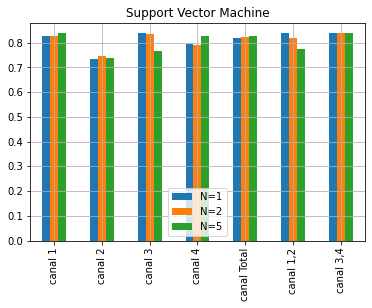

In [128]:
graficaSVM.plot(kind='bar',title="Support Vector Machine",grid=True)

graficasTipoClasificador.append(graficaSVM)

## 5.2 Decision Trees

In [129]:
numeroCaracteristicas=['N=1', 'N=2','N=5']
canales=['canal 1','canal 2','canal 3','canal 4','canal Total','canal 1,2','canal 3,4']

graficaTree=pd.DataFrame(index=canales,columns=numeroCaracteristicas)

### 5.2.1 Desicion Tree Total

In [130]:
for dato in RFEcompleto:
    
    print("N = " + str(len(dato.columns)) + " -------------------------->")
    print(dato)

    x=dato.to_numpy()
    y=valoresTotales['fatiga'].to_numpy()

    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.20)

    #Creo clasificador
    clasificadorTree = DecisionTreeClassifier(random_state=0)


    #Entreno
    clasificadorTree.fit(X_train,y_train)

    #Testeo 
    y_pred = clasificadorTree.predict(X_test)


    #Resultados
    print(confusion_matrix(y_test,y_pred))
    print(classification_report(y_test,y_pred))



    #Cross validation k-fold (precision total)
    resultados = cross_validate(clasificadorTree, x, y, cv=15)
    
    precision=resultados['test_score'].mean()
    desviacion=resultados['test_score'].std()
    print("Precision : " + str(precision) + " +/- " + str(desviacion))
    
    
    indice='N='+str(len(dato.columns))
    
    graficaTree[indice]['canal Total']=precision
    graficaCanalTotal[indice]['TREE']=precision
    graficaCanalTotalDesviacion[indice]['TREE']=desviacion

N = 1 -------------------------->
         IEMG
0    0.121682
1    0.037224
2    0.112433
3    0.090733
4    0.058599
..        ...
955  0.172382
956  0.122064
957  0.140693
958  0.126874
959  0.208488

[960 rows x 1 columns]
[[135  24]
 [ 28   5]]
              precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       159
         1.0       0.17      0.15      0.16        33

    accuracy                           0.73       192
   macro avg       0.50      0.50      0.50       192
weighted avg       0.72      0.73      0.72       192

Precision : 0.7375 +/- 0.05934758138851713
N = 2 -------------------------->
         IEMG       SSI
0    0.121682  0.048013
1    0.037224  0.011692
2    0.112433  0.040283
3    0.090733  0.032319
4    0.058599  0.021687
..        ...       ...
955  0.172382  0.172747
956  0.122064  0.106568
957  0.140693  0.117620
958  0.126874  0.118921
959  0.208488  0.225372

[960 rows x 2 columns]
[[144  15]
 [ 24   9]]
            

In [131]:
graficaTree

,N=1,N=2,N=5
canal 1,NaN,NaN,NaN
canal 2,NaN,NaN,NaN
canal 3,NaN,NaN,NaN
canal 4,NaN,NaN,NaN
canal Total,0.7375,0.740625,0.751042
"canal 1,2",NaN,NaN,NaN
"canal 3,4",NaN,NaN,NaN


### 5.2.2 Desicion Tree Canal 1, Canal 2, Canal 3, Canal 4

In [132]:
canal=1
for dato in datosFinales1234:
    
    if (canal>4):
        canal=1
    
    print("N = " + str(len(dato.columns)) + " -------------------------->")
    print("Valores de canal " + str(canal) + " ------>")
    
    print(dato)
    
    x=dato.to_numpy()
    y=valores1234['fatiga'].to_numpy()
    
    
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.20)

    #Creo clasificador
    clasificadorTree = DecisionTreeClassifier(random_state=0)

    #Entreno
    clasificadorTree.fit(X_train, y_train)

    #Testeo 
    y_pred = clasificadorTree.predict(X_test)

    
    #Resultados
    print(confusion_matrix(y_test,y_pred))
    print(classification_report(y_test,y_pred))
    

    
    #Cross validation k-fold (precision total)
    resultados = cross_validate(clasificadorTree, x, y, cv=15)
    
    
    precision=resultados['test_score'].mean()
    desviacion=resultados['test_score'].std()
    
    print("Precision : " + str(precision) + " +/- " + str(desviacion))
    
    
    indice='N='+str(len(dato.columns))
    graficaTree[indice]['canal '+str(canal)]=precision
    
    if (canal ==1):
        graficaCanal1[indice]['TREE']=precision
        graficaCanal1Desviacion[indice]['TREE']=desviacion
        
    elif (canal == 2):
        graficaCanal2[indice]['TREE']=precision
        graficaCanal2Desviacion[indice]['TREE']=desviacion
        
    elif (canal ==3):
        graficaCanal3[indice]['TREE']=precision
        graficaCanal3Desviacion[indice]['TREE']=desviacion
        
    elif (canal ==4):
        graficaCanal4[indice]['TREE']=precision
        graficaCanal4Desviacion[indice]['TREE']=desviacion
        
    canal=canal+1
    
    print("\n")
    
    
    
    

N = 1 -------------------------->
Valores de canal 1 ------>
        IEMG1
0    0.104327
1    0.018199
2    0.094894
3    0.072766
4    0.039997
..        ...
235  0.305169
236  0.218261
237  0.356641
238  0.262660
239  0.437335

[240 rows x 1 columns]
[[33  7]
 [ 7  1]]
              precision    recall  f1-score   support

         0.0       0.82      0.82      0.82        40
         1.0       0.12      0.12      0.12         8

    accuracy                           0.71        48
   macro avg       0.47      0.47      0.47        48
weighted avg       0.71      0.71      0.71        48

Precision : 0.7541666666666667 +/- 0.0980716857994985


N = 1 -------------------------->
Valores de canal 2 ------>
        IEMG2
0    0.248293
1    0.030632
2    0.244146
3    0.244722
4    0.117578
..        ...
235  0.005083
236  0.212890
237  0.027098
238  0.079068
239  0.215880

[240 rows x 1 columns]
[[40  3]
 [ 3  2]]
              precision    recall  f1-score   support

         0.0      

Precision : 0.7958333333333333 +/- 0.09537935951882998


N = 5 -------------------------->
Valores de canal 4 ------>
          ZC4      SSI4      TM34      TM44      MDF4
0    0.057971  0.011039  0.009532  0.032117  0.019498
1    0.156522  0.123554  0.066575  0.178326  0.085912
2    0.150725  0.147511  0.036820  0.172638  0.162266
3    0.220290  0.205569  0.077898  0.189877  0.219315
4    0.197101  0.176400  0.011955  0.254499  0.195875
..        ...       ...       ...       ...       ...
235  0.223188  0.224703  0.356692  0.665043  0.216261
236  0.165217  0.132853  0.034169  0.358029  0.138670
237  0.226087  0.148193  0.000612  0.298027  0.136085
238  0.168116  0.149999  0.066700  0.440023  0.155575
239  0.153623  0.297741  0.231964  0.788709  0.294815

[240 rows x 5 columns]
[[34  5]
 [ 4  5]]
              precision    recall  f1-score   support

         0.0       0.89      0.87      0.88        39
         1.0       0.50      0.56      0.53         9

    accuracy               

In [133]:
graficaTree

,N=1,N=2,N=5
canal 1,0.754167,0.729167,0.729167
canal 2,0.783333,0.770833,0.766667
canal 3,0.758333,0.6875,0.795833
canal 4,0.708333,0.733333,0.7
canal Total,0.7375,0.740625,0.751042
"canal 1,2",NaN,NaN,NaN
"canal 3,4",NaN,NaN,NaN


### 5.2.3 Decision Tree Canal 1,2

In [134]:
canal='canal 1,2'

for dato in RFEcanal12:
    
    print("N = " + str(len(dato.columns)) + " -------------------------->")
    print(dato)
    
    
    x=dato.to_numpy()
    y=valores12['fatiga'].to_numpy()

    
    #y=np.random.randint(2,size=1056)
    
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.20)
    
    #Creo clasificador
    clasificadorTree = DecisionTreeClassifier(random_state=0)


    #Entreno
    clasificadorTree.fit(X_train, y_train)

    #Testeo 
    y_pred = clasificadorTree.predict(X_test)


    #Resultados
    print(confusion_matrix(y_test,y_pred))
    print(classification_report(y_test,y_pred))



    #Cross validation k-fold (precision total)
    resultados = cross_validate(clasificadorTree, x, y, cv=15)
    
    precision=resultados['test_score'].mean()
    desviacion=resultados['test_score'].std()
    print("Precision : " + str(precision) + " +/- " + str(desviacion))
    
    
    indice='N='+str(len(dato.columns))
    
    graficaTree[indice][canal]=precision
    graficaCanal12[indice]['TREE']=precision
    graficaCanal12Desviacion[indice]['TREE']=desviacion

N = 1 -------------------------->
          RMS
0    0.112904
1    0.079236
2    0.073628
3    0.088639
4    0.099598
..        ...
475  0.124753
476  0.513304
477  0.429387
478  0.419884
479  0.604293

[480 rows x 1 columns]
[[63 19]
 [10  4]]
              precision    recall  f1-score   support

         0.0       0.86      0.77      0.81        82
         1.0       0.17      0.29      0.22        14

    accuracy                           0.70        96
   macro avg       0.52      0.53      0.51        96
weighted avg       0.76      0.70      0.73        96

Precision : 0.7333333333333333 +/- 0.05212498334665335
N = 2 -------------------------->
          RMS       VAR
0    0.112904  0.054549
1    0.079236  0.036963
2    0.073628  0.033778
3    0.088639  0.041559
4    0.099598  0.047487
..        ...       ...
475  0.124753  0.064083
476  0.513304  0.368607
477  0.429387  0.290841
478  0.419884  0.279649
479  0.604293  0.466047

[480 rows x 2 columns]
[[67 14]
 [13  2]]
        

In [135]:
graficaTree

,N=1,N=2,N=5
canal 1,0.754167,0.729167,0.729167
canal 2,0.783333,0.770833,0.766667
canal 3,0.758333,0.6875,0.795833
canal 4,0.708333,0.733333,0.7
canal Total,0.7375,0.740625,0.751042
"canal 1,2",0.733333,0.733333,0.747917
"canal 3,4",NaN,NaN,NaN


### 5.2.4 Decision Tree Canal 3,4

In [136]:
canal='canal 3,4'

for dato in RFEcanal34:
    
    print("N = " + str(len(dato.columns)) + " -------------------------->")
    print(dato)
    
    
    x=dato.to_numpy()
    y=valores34['fatiga'].to_numpy()

    
    #y=np.random.randint(2,size=1056)
    
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.20)
    
    #Creo clasificador
    clasificadorTree = DecisionTreeClassifier(random_state=0)


    #Entreno
    clasificadorTree.fit(X_train, y_train)

    #Testeo 
    y_pred = clasificadorTree.predict(X_test)


    #Resultados
    print(confusion_matrix(y_test,y_pred))
    print(classification_report(y_test,y_pred))



    #Cross validation k-fold (precision total)
    resultados = cross_validate(clasificadorTree, x, y, cv=15)
    
    precision=resultados['test_score'].mean()
    desviacion=resultados['test_score'].std()
    
    print("Precision : " + str(precision) + " +/- " + str(desviacion))
    
    indice='N='+str(len(dato.columns))
    
    graficaTree[indice][canal]=precision
    graficaCanal34[indice]['TREE']=precision
    graficaCanal34Desviacion[indice]['TREE']=desviacion

N = 1 -------------------------->
          RMS
0    0.331273
1    0.241065
2    0.270855
3    0.276080
4    0.261665
..        ...
475  0.671051
476  0.550686
477  0.543528
478  0.610175
479  0.769511

[480 rows x 1 columns]
[[69 16]
 [ 9  2]]
              precision    recall  f1-score   support

         0.0       0.88      0.81      0.85        85
         1.0       0.11      0.18      0.14        11

    accuracy                           0.74        96
   macro avg       0.50      0.50      0.49        96
weighted avg       0.80      0.74      0.77        96

Precision : 0.73125 +/- 0.06827487336739141
N = 2 -------------------------->
          RMS       VAR
0    0.331273  0.190592
1    0.241065  0.124890
2    0.270855  0.145416
3    0.276080  0.149127
4    0.261665  0.139008
..        ...       ...
475  0.671051  0.531451
476  0.550686  0.394202
477  0.543528  0.386458
478  0.610175  0.459941
479  0.769511  0.657521

[480 rows x 2 columns]
[[68 10]
 [12  6]]
              preci

In [137]:
graficaTree

,N=1,N=2,N=5
canal 1,0.754167,0.729167,0.729167
canal 2,0.783333,0.770833,0.766667
canal 3,0.758333,0.6875,0.795833
canal 4,0.708333,0.733333,0.7
canal Total,0.7375,0.740625,0.751042
"canal 1,2",0.733333,0.733333,0.747917
"canal 3,4",0.73125,0.735417,0.735417


<AxesSubplot:title={'center':'Decision Tree'}>

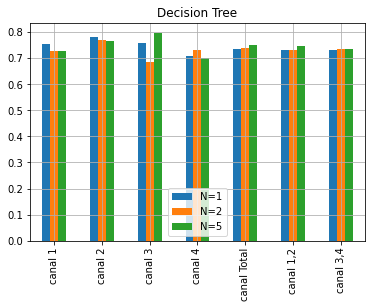

In [138]:
graficasTipoClasificador.append(graficaTree)
graficaTree.plot(kind='bar',title="Decision Tree",grid=True)

## 5.3 Nearest Neighbors Classification (KNN)

In [139]:
numeroCaracteristicas=['N=1', 'N=2','N=5']
canales=['canal 1','canal 2','canal 3','canal 4','canal Total','canal 1,2','canal 3,4']

graficaKNN=pd.DataFrame(index=canales,columns=numeroCaracteristicas)

### 5.3.1 KNN Total

In [140]:
canal='canal Total'


for dato in RFEcompleto:
    
    print("N = " + str(len(dato.columns)) + " -------------------------->")
    print(dato)
    
    x=dato.to_numpy()
    y=valoresTotales['fatiga'].to_numpy()



    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.20)

    #K=6
    KNN = KNeighborsClassifier(n_neighbors=6)
    
    KNN.fit(X_train, y_train)


    y_pred = KNN.predict(X_test)

    #Resultados
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))

    
    #Cross validation k-fold (precision total)
    resultados = cross_validate(KNN, x, y, cv=15)
    
    precision=resultados['test_score'].mean()
    desviacion=resultados['test_score'].std()
    
    print("Precision : " + str(precision) + " +/- " + str(desviacion))
    
    indice='N='+str(len(dato.columns))
    
    graficaKNN[indice][canal]=precision
    graficaCanalTotal[indice]['KNN']=precision
    graficaCanalTotalDesviacion[indice]['KNN']=desviacion

N = 1 -------------------------->
         IEMG
0    0.121682
1    0.037224
2    0.112433
3    0.090733
4    0.058599
..        ...
955  0.172382
956  0.122064
957  0.140693
958  0.126874
959  0.208488

[960 rows x 1 columns]
[[155   2]
 [ 32   3]]
              precision    recall  f1-score   support

         0.0       0.83      0.99      0.90       157
         1.0       0.60      0.09      0.15        35

    accuracy                           0.82       192
   macro avg       0.71      0.54      0.53       192
weighted avg       0.79      0.82      0.76       192

Precision : 0.8416666666666667 +/- 0.01698906919822926
N = 2 -------------------------->
         IEMG       SSI
0    0.121682  0.048013
1    0.037224  0.011692
2    0.112433  0.040283
3    0.090733  0.032319
4    0.058599  0.021687
..        ...       ...
955  0.172382  0.172747
956  0.122064  0.106568
957  0.140693  0.117620
958  0.126874  0.118921
959  0.208488  0.225372

[960 rows x 2 columns]
[[156   0]
 [ 30   6]]


In [141]:
graficaKNN

,N=1,N=2,N=5
canal 1,NaN,NaN,NaN
canal 2,NaN,NaN,NaN
canal 3,NaN,NaN,NaN
canal 4,NaN,NaN,NaN
canal Total,0.841667,0.845833,0.835417
"canal 1,2",NaN,NaN,NaN
"canal 3,4",NaN,NaN,NaN


### 5.3.2 KNN: Canal 1, Canal 2, Canal 3, Canal 4

In [142]:
canal=1
for dato in datosFinales1234:
    if (canal > 4):
        canal=1
    
    print("N = " + str(len(dato.columns)) + " -------------------------->")
    print("Valores de canal " + str(canal) + " ------>")
    
    print(dato)
    
    x=dato.to_numpy()
    y=valores1234['fatiga'].to_numpy()
    
    
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.20)

    #K=6
    KNN = KNeighborsClassifier(n_neighbors=6)
    
    KNN.fit(X_train, y_train)


    y_pred = KNN.predict(X_test)

    #Resultados
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))

    
    #Cross validation k-fold (precision total)
    resultados = cross_validate(KNN, x, y, cv=15)
    
    precision=resultados['test_score'].mean()
    desviacion=resultados['test_score'].std()
    
    print("Precision : " + str(precision) + " +/- " + str(desviacion))
    
    indice='N='+str(len(dato.columns))
    
    
    graficaKNN[indice]['canal '+str(canal)]=precision
    if (canal ==1):
        graficaCanal1[indice]['KNN']=precision
        graficaCanal1Desviacion[indice]['KNN']=desviacion
        
    elif (canal == 2):
        graficaCanal2[indice]['KNN']=precision
        graficaCanal2Desviacion[indice]['KNN']=desviacion
        
    elif (canal ==3):
        graficaCanal3[indice]['KNN']=precision
        graficaCanal3Desviacion[indice]['KNN']=desviacion
        
    elif (canal ==4):
        graficaCanal4[indice]['KNN']=precision
        graficaCanal4Desviacion[indice]['KNN']=desviacion
        
    canal=canal+1
    
    print("\n")
    

N = 1 -------------------------->
Valores de canal 1 ------>
        IEMG1
0    0.104327
1    0.018199
2    0.094894
3    0.072766
4    0.039997
..        ...
235  0.305169
236  0.218261
237  0.356641
238  0.262660
239  0.437335

[240 rows x 1 columns]
[[42  0]
 [ 6  0]]
              precision    recall  f1-score   support

         0.0       0.88      1.00      0.93        42
         1.0       0.00      0.00      0.00         6

    accuracy                           0.88        48
   macro avg       0.44      0.50      0.47        48
weighted avg       0.77      0.88      0.82        48

Precision : 0.825 +/- 0.05204164998665331


N = 1 -------------------------->
Valores de canal 2 ------>
        IEMG2
0    0.248293
1    0.030632
2    0.244146
3    0.244722
4    0.117578
..        ...
235  0.005083
236  0.212890
237  0.027098
238  0.079068
239  0.215880

[240 rows x 1 columns]
[[37  1]
 [10  0]]
              precision    recall  f1-score   support

         0.0       0.79      0

/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision : 0.8333333333333334 +/- 0.0372677996249965


N = 2 -------------------------->
Valores de canal 1 ------>
          WL1     IEMG1
0    0.121713  0.104327
1    0.024804  0.018199
2    0.127078  0.094894
3    0.085743  0.072766
4    0.046944  0.039997
..        ...       ...
235  0.250640  0.305169
236  0.177800  0.218261
237  0.269131  0.356641
238  0.212002  0.262660
239  0.310141  0.437335

[240 rows x 2 columns]
[[39  1]
 [ 8  0]]
              precision    recall  f1-score   support

         0.0       0.83      0.97      0.90        40
         1.0       0.00      0.00      0.00         8

    accuracy                           0.81        48
   macro avg       0.41      0.49      0.45        48
weighted avg       0.69      0.81      0.75        48

Precision : 0.8291666666666667 +/- 0.04823265376162594


N = 2 -------------------------->
Valores de canal 2 ------>
        IEMG2      MDF2
0    0.248293  0.262619
1    0.030632  0.012210
2    0.244146  0.243097
3    0.2447

/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision : 0.8416666666666667 +/- 0.031180478223116186


N = 5 -------------------------->
Valores de canal 1 ------>
          ZC1       WL1     IEMG1      TM41      ACC1
0    0.247642  0.121713  0.104327  0.010294  0.185761
1    0.056604  0.024804  0.018199  0.003252  0.208452
2    0.290094  0.127078  0.094894  0.005307  0.203427
3    0.167453  0.085743  0.072766  0.004415  0.174129
4    0.094340  0.046944  0.039997  0.006891  0.162880
..        ...       ...       ...       ...       ...
235  0.158019  0.250640  0.305169  0.568737  0.799262
236  0.117925  0.177800  0.218261  0.451391  0.718958
237  0.160377  0.269131  0.356641  0.656083  0.750852
238  0.141509  0.212002  0.262660  0.760044  0.701828
239  0.169811  0.310141  0.437335  0.919953  0.760332

[240 rows x 5 columns]
[[41  1]
 [ 4  2]]
              precision    recall  f1-score   support

         0.0       0.91      0.98      0.94        42
         1.0       0.67      0.33      0.44         6

    accuracy              

In [143]:
graficaKNN

,N=1,N=2,N=5
canal 1,0.825,0.829167,0.833333
canal 2,0.845833,0.833333,0.841667
canal 3,0.825,0.820833,0.820833
canal 4,0.833333,0.841667,0.8125
canal Total,0.841667,0.845833,0.835417
"canal 1,2",NaN,NaN,NaN
"canal 3,4",NaN,NaN,NaN


### 5.3.3 KNN: Canal (1,2)

In [144]:
canal='canal 1,2'

for dato in RFEcanal12:
    
    print("N = " + str(len(dato.columns)) + " -------------------------->")
    print(dato)
    
    
    x=dato.to_numpy()
    y=valores12['fatiga'].to_numpy()
    
    
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.20)

    #K=6
    KNN = KNeighborsClassifier(n_neighbors=6)
    
    KNN.fit(X_train, y_train)


    y_pred = KNN.predict(X_test)

    #Resultados
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))

    
    #Cross validation k-fold (precision total)
    resultados = cross_validate(KNN, x, y, cv=15)
    
    precision=resultados['test_score'].mean()
    desviacion=resultados['test_score'].std()
    
    print("Precision : " + str(precision) + " +/- " + str(desviacion))
    
    
    indice='N='+str(len(dato.columns))
    
    graficaKNN[indice][canal]=precision
    graficaCanal12[indice]['KNN']=precision
    graficaCanal12Desviacion[indice]['KNN']=desviacion
    

N = 1 -------------------------->
          RMS
0    0.112904
1    0.079236
2    0.073628
3    0.088639
4    0.099598
..        ...
475  0.124753
476  0.513304
477  0.429387
478  0.419884
479  0.604293

[480 rows x 1 columns]
[[86  0]
 [10  0]]
              precision    recall  f1-score   support

         0.0       0.90      1.00      0.95        86
         1.0       0.00      0.00      0.00        10

    accuracy                           0.90        96
   macro avg       0.45      0.50      0.47        96
weighted avg       0.80      0.90      0.85        96

Precision : 0.8229166666666666 +/- 0.018633899812498248
N = 2 -------------------------->
          RMS       VAR
0    0.112904  0.054549
1    0.079236  0.036963
2    0.073628  0.033778
3    0.088639  0.041559
4    0.099598  0.047487
..        ...       ...
475  0.124753  0.064083
476  0.513304  0.368607
477  0.429387  0.290841
478  0.419884  0.279649
479  0.604293  0.466047

[480 rows x 2 columns]
[[73  4]
 [17  2]]
       

/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision : 0.8333333333333334 +/- 0.031595314350214794


In [145]:
graficaKNN

,N=1,N=2,N=5
canal 1,0.825,0.829167,0.833333
canal 2,0.845833,0.833333,0.841667
canal 3,0.825,0.820833,0.820833
canal 4,0.833333,0.841667,0.8125
canal Total,0.841667,0.845833,0.835417
"canal 1,2",0.822917,0.822917,0.833333
"canal 3,4",NaN,NaN,NaN


### 5.3.4 KNN: Canal (3,4) 

In [146]:
canal='canal 3,4'

for dato in RFEcanal34:
    
    print("N = " + str(len(dato.columns)) + " -------------------------->")
    print(dato)
    
    
    x=dato.to_numpy()
    y=valores34['fatiga'].to_numpy()
    
    
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.20)

    #K=6
    KNN = KNeighborsClassifier(n_neighbors=6)
    
    KNN.fit(X_train, y_train)


    y_pred = KNN.predict(X_test)

    #Resultados
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))

    
    #Cross validation k-fold (precision total)
    resultados = cross_validate(KNN, x, y, cv=15)
    precision=resultados['test_score'].mean()
    desviacion=resultados['test_score'].std()
    
    print("Precision : " + str(precision) + " +/- " + str(desviacion))
    
    indice='N='+str(len(dato.columns))
    
    graficaKNN[indice][str(canal)]=precision
    graficaCanal34[indice]['KNN']=precision
    graficaCanal34Desviacion[indice]['KNN']=desviacion

N = 1 -------------------------->
          RMS
0    0.331273
1    0.241065
2    0.270855
3    0.276080
4    0.261665
..        ...
475  0.671051
476  0.550686
477  0.543528
478  0.610175
479  0.769511

[480 rows x 1 columns]
[[75  1]
 [20  0]]
              precision    recall  f1-score   support

         0.0       0.79      0.99      0.88        76
         1.0       0.00      0.00      0.00        20

    accuracy                           0.78        96
   macro avg       0.39      0.49      0.44        96
weighted avg       0.62      0.78      0.69        96

Precision : 0.8270833333333333 +/- 0.01932003853228272
N = 2 -------------------------->
          RMS       VAR
0    0.331273  0.190592
1    0.241065  0.124890
2    0.270855  0.145416
3    0.276080  0.149127
4    0.261665  0.139008
..        ...       ...
475  0.671051  0.531451
476  0.550686  0.394202
477  0.543528  0.386458
478  0.610175  0.459941
479  0.769511  0.657521

[480 rows x 2 columns]
[[86  0]
 [10  0]]
        

/home/juanma/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [147]:
graficaKNN

,N=1,N=2,N=5
canal 1,0.825,0.829167,0.833333
canal 2,0.845833,0.833333,0.841667
canal 3,0.825,0.820833,0.820833
canal 4,0.833333,0.841667,0.8125
canal Total,0.841667,0.845833,0.835417
"canal 1,2",0.822917,0.822917,0.833333
"canal 3,4",0.827083,0.825,0.827083


<AxesSubplot:title={'center':'Nearest Neighbors Classification(KNN)'}>

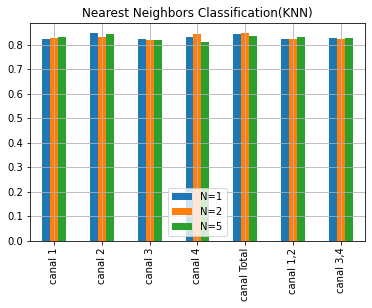

In [148]:
graficasTipoClasificador.append(graficaKNN)
graficaKNN.plot(kind='bar',title="Nearest Neighbors Classification(KNN)",grid=True)

# 6. Conclusiones

<AxesSubplot:title={'center':'graficaGeneral'}>

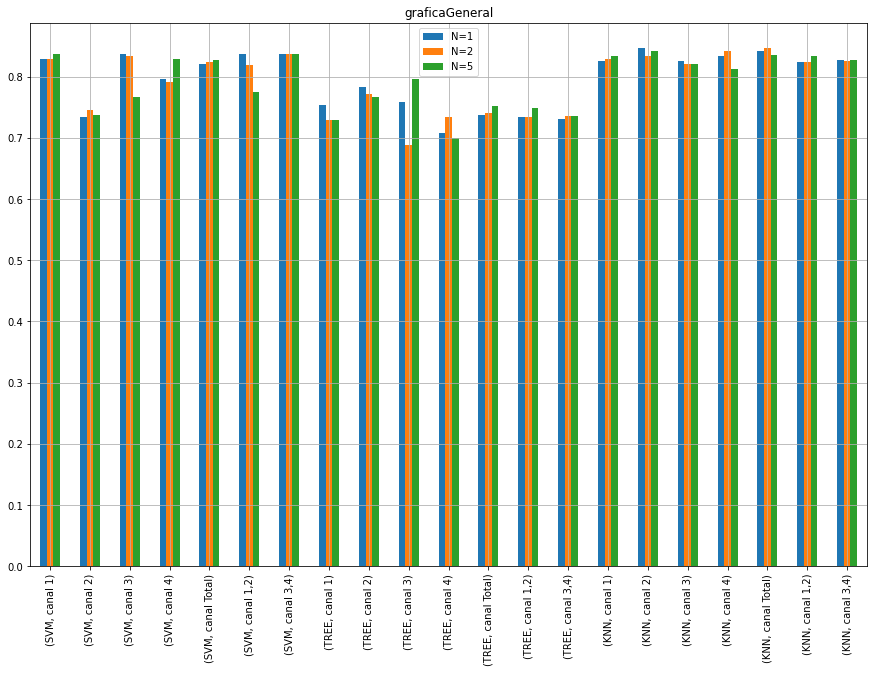

In [149]:
clasificadores=['SVM','TREE','KNN']

graficaGeneral = pd.concat(graficasTipoClasificador,keys=clasificadores)

graficaGeneral.plot(kind='bar',title="graficaGeneral",grid=True,figsize=(15,10))


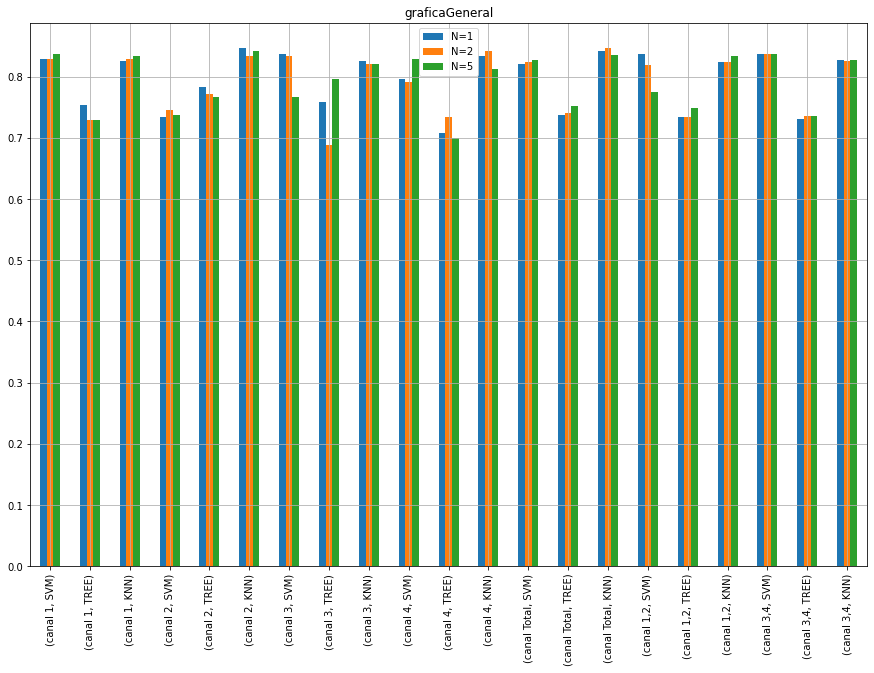

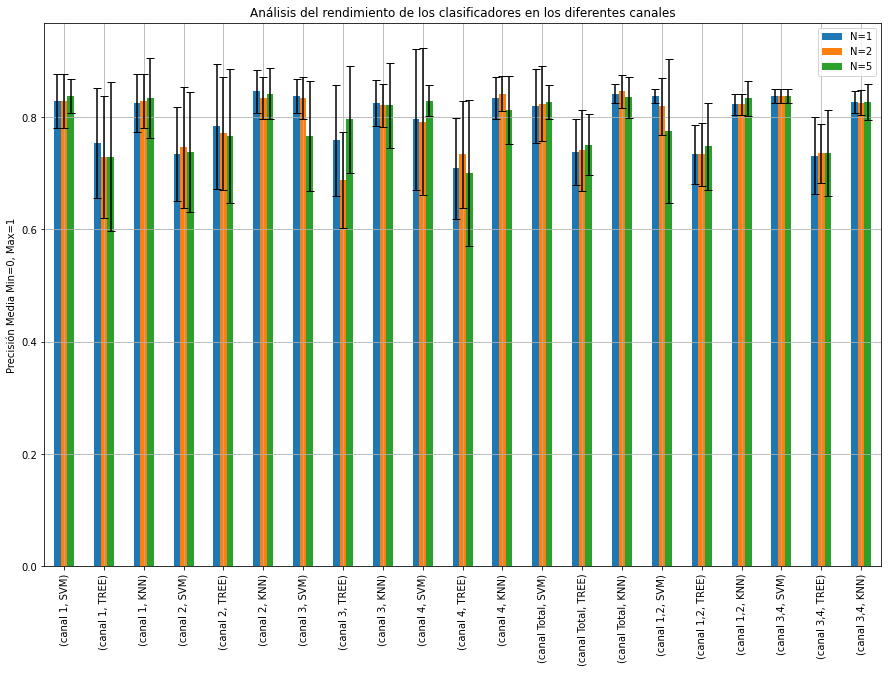

In [154]:
graficasCanales=[graficaCanal1,graficaCanal2,graficaCanal3,graficaCanal4,graficaCanalTotal,graficaCanal12,graficaCanal34]

graficasCanalesDesviacion=[graficaCanal1Desviacion,graficaCanal2Desviacion,graficaCanal3Desviacion,
                           graficaCanal4Desviacion,graficaCanalTotalDesviacion,graficaCanal12Desviacion,
                           graficaCanal34Desviacion]

canales=['canal 1','canal 2','canal 3','canal 4','canal Total','canal 1,2','canal 3,4']

graficaGeneralCanales = pd.concat(graficasCanales,keys=canales)
graficaGeneralCanalesDesviacion=pd.concat(graficasCanalesDesviacion,keys=canales)

graficaGeneralCanales.plot(kind='bar',title="graficaGeneral",grid=True,figsize=(15,10))
graficaGeneralCanales.plot(kind='bar',title="Análisis del rendimiento de los clasificadores en los diferentes canales",grid=True,figsize=(15,10),capsize=4,yerr=graficaGeneralCanalesDesviacion)
plt.ylabel("Precisión Media Min=0, Max=1")
plt.savefig("grafica y tablas/Grafica analisis final.jpg")
#graficaGeneralCanales.plot.bar(yerr=graficaGeneralCanalesDesviacion,figsize=(15,10),capsize=4)

In [152]:
print(graficaGeneralCanales.to_latex(multirow=True,caption="Precisiones medias de los clasificadores en cada canal",bold_rows=True))
graficaGeneralCanales

\begin{table}
\centering
\caption{Precisiones medias de los clasificadores en cada canal}
\begin{tabular}{lllll}
\toprule
          &     &       N=1 &       N=2 &       N=5 \\
\midrule
\multirow{3}{*}{\textbf{canal 1}} & \textbf{SVM} &  0.829167 &  0.829167 &    0.8375 \\
          & \textbf{TREE} &  0.754167 &  0.729167 &  0.729167 \\
          & \textbf{KNN} &     0.825 &  0.829167 &  0.833333 \\
\cline{1-5}
\multirow{3}{*}{\textbf{canal 2}} & \textbf{SVM} &  0.733333 &  0.745833 &    0.7375 \\
          & \textbf{TREE} &  0.783333 &  0.770833 &  0.766667 \\
          & \textbf{KNN} &  0.845833 &  0.833333 &  0.841667 \\
\cline{1-5}
\multirow{3}{*}{\textbf{canal 3}} & \textbf{SVM} &    0.8375 &  0.833333 &  0.766667 \\
          & \textbf{TREE} &  0.758333 &    0.6875 &  0.795833 \\
          & \textbf{KNN} &     0.825 &  0.820833 &  0.820833 \\
\cline{1-5}
\multirow{3}{*}{\textbf{canal 4}} & \textbf{SVM} &  0.795833 &  0.791667 &  0.829167 \\
          & \textbf{TREE} &  0.708333 &

N=1       N=2       N=5
canal 1     SVM   0.829167  0.829167    0.8375
            TREE  0.754167  0.729167  0.729167
            KNN      0.825  0.829167  0.833333
canal 2     SVM   0.733333  0.745833    0.7375
            TREE  0.783333  0.770833  0.766667
            KNN   0.845833  0.833333  0.841667
canal 3     SVM     0.8375  0.833333  0.766667
            TREE  0.758333    0.6875  0.795833
            KNN      0.825  0.820833  0.820833
canal 4     SVM   0.795833  0.791667  0.829167
            TREE  0.708333  0.733333       0.7
            KNN   0.833333  0.841667    0.8125
canal Total SVM   0.819792  0.823958  0.827083
            TREE    0.7375  0.740625  0.751042
            KNN   0.841667  0.845833  0.835417
canal 1,2   SVM     0.8375   0.81875     0.775
            TREE  0.733333  0.733333  0.747917
            KNN   0.822917  0.822917  0.833333
canal 3,4   SVM     0.8375    0.8375    0.8375
            TREE   0.73125  0.735417  0.735417
            KNN   0.827083     0.825  0.827083

In [151]:
print(graficaGeneralCanalesDesviacion.to_latex(multirow=True,caption="Desviacion típica de los clasificadores en cada canal",bold_rows=True))
graficaGeneralCanalesDesviacion

\begin{table}
\centering
\caption{Desviacion típica de los clasificadores en cada canal}
\begin{tabular}{lllll}
\toprule
          &     &        N=1 &        N=2 &        N=5 \\
\midrule
\multirow{3}{*}{\textbf{canal 1}} & \textbf{SVM} &  0.0482327 &  0.0482327 &  0.0306186 \\
          & \textbf{TREE} &  0.0980717 &   0.108653 &   0.132419 \\
          & \textbf{KNN} &  0.0520416 &  0.0482327 &  0.0709558 \\
\cline{1-5}
\multirow{3}{*}{\textbf{canal 2}} & \textbf{SVM} &   0.083749 &   0.108173 &   0.107529 \\
          & \textbf{TREE} &   0.111492 &   0.101208 &   0.119606 \\
          & \textbf{KNN} &  0.0386401 &  0.0372678 &  0.0448764 \\
\cline{1-5}
\multirow{3}{*}{\textbf{canal 3}} & \textbf{SVM} &  0.0306186 &  0.0372678 &  0.0980717 \\
          & \textbf{TREE} &  0.0991281 &  0.0853913 &  0.0953794 \\
          & \textbf{KNN} &  0.0408248 &  0.0386401 &  0.0752311 \\
\cline{1-5}
\multirow{3}{*}{\textbf{canal 4}} & \textbf{SVM} &   0.125968 &   0.130437 &  0.0276385 \\
       

N=1        N=2        N=5
canal 1     SVM   0.0482327  0.0482327  0.0306186
            TREE  0.0980717   0.108653   0.132419
            KNN   0.0520416  0.0482327  0.0709558
canal 2     SVM    0.083749   0.108173   0.107529
            TREE   0.111492   0.101208   0.119606
            KNN   0.0386401  0.0372678  0.0448764
canal 3     SVM   0.0306186  0.0372678  0.0980717
            TREE  0.0991281  0.0853913  0.0953794
            KNN   0.0408248  0.0386401  0.0752311
canal 4     SVM    0.125968   0.130437  0.0276385
            TREE  0.0903312  0.0953794   0.129502
            KNN   0.0372678  0.0311805  0.0603807
canal Total SVM   0.0660124  0.0661602  0.0304409
            TREE  0.0593476  0.0721237   0.053966
            KNN   0.0169891  0.0295731  0.0364732
canal 1,2   SVM      0.0125       0.05   0.128695
            TREE   0.052125  0.0557462   0.077784
            KNN   0.0186339  0.0186339  0.0315953
canal 3,4   SVM      0.0125     0.0125     0.0125
            TREE  0.0682749   0.052125  0.0764331
            KNN     0.01932  0.0222439  0.0320048